In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegressionCV
import sklearn.metrics as metrics
from sklearn.preprocessing import PolynomialFeatures
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import export_graphviz
from IPython.display import Image
from IPython.display import display
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn import discriminant_analysis
from sklearn.tree import export_graphviz
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import statsmodels.api as sm
from statsmodels.api import OLS
from sklearn import linear_model, datasets
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV
import seaborn.apionly as sns
from scipy import stats
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LogisticRegression

In [2]:
import pandas as pd
df = pd.read_csv('ADNIMERGE_full.csv')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)  
df.head()

,RID,PTID,VISCODE,SITE,COLPROT,ORIGPROT,EXAMDATE,DX_bl,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,APOE4,FDG,PIB,AV45,CDRSB,ADAS11,ADAS13,MMSE,RAVLT_immediate,RAVLT_learning,RAVLT_forgetting,RAVLT_perc_forgetting,FAQ,MOCA,EcogPtMem,EcogPtLang,EcogPtVisspat,EcogPtPlan,EcogPtOrgan,EcogPtDivatt,EcogPtTotal,EcogSPMem,EcogSPLang,EcogSPVisspat,EcogSPPlan,EcogSPOrgan,EcogSPDivatt,EcogSPTotal,FLDSTRENG,FSVERSION,Ventricles,Hippocampus,WholeBrain,Entorhinal,Fusiform,MidTemp,ICV,DX,EXAMDATE_bl,CDRSB_bl,ADAS11_bl,ADAS13_bl,MMSE_bl,RAVLT_immediate_bl,RAVLT_learning_bl,RAVLT_forgetting_bl,RAVLT_perc_forgetting_bl,FAQ_bl,FLDSTRENG_bl,FSVERSION_bl,Ventricles_bl,Hippocampus_bl,WholeBrain_bl,Entorhinal_bl,Fusiform_bl,MidTemp_bl,ICV_bl,MOCA_bl,EcogPtMem_bl,EcogPtLang_bl,EcogPtVisspat_bl,EcogPtPlan_bl,EcogPtOrgan_bl,EcogPtDivatt_bl,EcogPtTotal_bl,EcogSPMem_bl,EcogSPLang_bl,EcogSPVisspat_bl,EcogSPPlan_bl,EcogSPOrgan_bl,EcogSPDivatt_bl,EcogSPTotal_bl,FDG_bl,PIB_bl,AV45_bl,Years_bl,Month_bl,Month,M,update_stamp
0,2,011_S_0002,bl,11,ADNI1,ADNI1,9/8/2005,CN,74.3,Male,16,Not Hisp/Latino,White,Married,0.0,1.36926,NaN,NaN,0.0,10.67,18.67,28.0,44.0,4.0,6.0,54.5455,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,118233.0,8336.0,1229740.0,4177.0,16559.0,27936.0,1984660.0,CN,9/8/2005,0.0,10.67,18.67,28,44.0,4.0,6.0,54.5455,0.0,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,118233.0,8336.0,1229740.0,4177.0,16559.0,27936.0,1984660.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.36926,NaN,NaN,0.000000,0.00000,0,0,50:48.0
1,3,011_S_0003,bl,11,ADNI1,ADNI1,9/12/2005,AD,81.3,Male,18,Not Hisp/Latino,White,Married,1.0,1.09079,NaN,NaN,4.5,22.00,31.00,20.0,22.0,1.0,4.0,100.0000,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,84599.0,5319.0,1129830.0,1791.0,15506.0,18422.0,1920690.0,Dementia,9/12/2005,4.5,22.00,31.00,20,22.0,1.0,4.0,100.0000,10.0,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,84599.0,5319.0,1129830.0,1791.0,15506.0,18422.0,1920690.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.09079,NaN,NaN,0.000000,0.00000,0,0,50:48.0
2,3,011_S_0003,m06,11,ADNI1,ADNI1,3/13/2006,AD,81.3,Male,18,Not Hisp/Latino,White,Married,1.0,1.06360,NaN,NaN,6.0,19.00,30.00,24.0,19.0,2.0,6.0,100.0000,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,88580.0,5446.0,1100060.0,2427.0,14400.0,16972.0,1906430.0,Dementia,9/12/2005,4.5,22.00,31.00,20,22.0,1.0,4.0,100.0000,10.0,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,84599.0,5319.0,1129830.0,1791.0,15506.0,18422.0,1920690.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.09079,NaN,NaN,0.498289,5.96721,6,6,50:48.0
3,3,011_S_0003,m12,11,ADNI1,ADNI1,9/12/2006,AD,81.3,Male,18,Not Hisp/Latino,White,Married,1.0,1.10384,NaN,NaN,3.5,24.00,35.00,17.0,31.0,2.0,7.0,100.0000,17.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,90099.0,5157.0,1095640.0,1596.0,14617.0,17330.0,1903820.0,Dementia,9/12/2005,4.5,22.00,31.00,20,22.0,1.0,4.0,100.0000,10.0,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,84599.0,5319.0,1129830.0,1791.0,15506.0,18422.0,1920690.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.09079,NaN,NaN,0.999316,11.96720,12,12,50:48.0
4,3,011_S_0003,m24,11,ADNI1,ADNI1,9/12/2007,AD,81.3,Male,18,Not Hisp/Latino,White,Married,1.0,1.03871,NaN,NaN,8.0,25.67,37.67,19.0,23.0,1.0,5.0,100.0000,14.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,97420.0,5139.0,1088560.0,1175.0,14033.0,16398.0,1903420.0,Dementia,9/12/2005,4.5,22.00,31.00,20,22.0,1.0,4.0,100.0000,10.0,1.5 Tesla MRI,Cross-Sectional FreeSurfer (FreeSurfer Version...,845

In [3]:
df.shape[0]

13017

In [4]:
df_dict = pd.read_csv('ADNIMERGE_DICT.csv')
df_dict.head()

,ID,FLDNAME,TBLNAME,CRFNAME,QUESTION,TEXT,NOTES,OBJID,COLID,RANGEJSCPT,NAVJSCPT,FTYPE,TAB,DE,MC,VISIBLE,LOGVISIBLE,MTBLNAME,SUBTBLNAME,POPJSCPT,GRID,DEF,update_stamp
0,-4,RID,ADNIMERGE,Key ADNI tables merged into one table,-4,Participant roster ID,The 4 digit roster ID (RID) should be used to ...,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,36:06.0
1,-4,PTID,ADNIMERGE,Key ADNI tables merged into one table,-4,Participant ID,3 digit site number and 4 digit roster ID (RID...,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,36:06.0
2,-4,VISCODE,ADNIMERGE,Key ADNI tables merged into one table,-4,Visit code,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,36:06.0
3,-4,SITE,ADNIMERGE,Key ADNI tables merged into one table,-4,Site,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,36:06.0
4,-4,COLPROT,ADNIMERGE,Key ADNI tables merged into one table,-4,Protocol under which data was collected,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,-4,36:06.0


# 1. Project Scope: 
We looked at the contribution of genetic factors in predicting a person's Alzheimer's status at baseline. To that end we worked with two datasets:
- ADNIMERGE_full
- ADNI_Gene_Expression_Profile
We focused on expanding the ADNIMERGE dataset and did not take into account the longitudinal aspect of the data. We chose the ADNI2 cohort because the gene expression data was collected only for ADNI2 and ADNIGO, thus ADNI1 is a no-go. Since it would be complicated to find variables common to both ADNI2 and ADNIGO, we dropped one or the either without creating any additional bias in the dataset. our final decision is to work on ADNI2 dataset specifically.

# 2. Description of the Datasets
The data encompasses the baseline cognitive statues of a subject and follows his/her progress over a period of mutliple visits. This is the dependent variable 'DX'. The data includes a broad range of predictor categories namely: they are genetic; neuropsychological, everday cognitive and functional tests, MRI to measure changes in brain volume and PET data which looks into brain glucose metabolism. ADNIMERGE_full is the composite data set that pulls on important predictors from all these categories into one snapshot. There are extensive databases of each of these different categories by the different cohorts (ADNI 1, ADNI 2 and ADNIGO) some of which are beyond the compute power our laptops (which was an important cosideration of which dataset we wanted to expand).  


# 2.1 Cleaning up the dataset (for EDA)

### ADNIMERGE_full: 
We chose only baseline visit data because:
- we need some criteria to have a unique key of each observation. Problem is a single patient (PTID) has multiple visits, so either we combine multiple data points into a longitudinal factor or keep only one visit. We chose to ignore the longitudinal aspect since we are focusing on extending the dataset.
- We want to extend the dataset based on genetic expression data, which does not have have a longitudinal aspect (since a person's genes are set at birth) hence keeping only the baseline data can be justified.

Additionally, we got rid of administrative data, endline obserations, and the predictor called 'CDR', which is one of the advanced symptoms of Alzheimer's, and is highly predictive of an 'AD' status for a subject.

### ADNI Gene Expression Profile: 
This dataset contains the gene expression profile subjects with information on Gene LocusLinks which contains the information on the gene symbols. In order to clean the data, we have taken following steps:
- Since we are working with only ADNI2, we filtered out ADNIGO observations.
- Using the probe set with suffix '-at' we narrowed down unique Locus Links and then unique Gene Symbols (details were provided in our MileStone 3 and are provided in the Appendix). This resultied in a Gene Experession profile for individual patients.

### Mering the datasets
The two datasets were merged by the unique PID resulting in **372 observations and 7455 columns.**

### Combining the dependent variable into three categories
There were five categories in the DX, but we compbined into three to improve our prediction accuracy and then converted to a numerical variable.
- CN = SMC + CN = 1
- MCI = LMCI + EMCI = 2
- AD = AD =3 

In [5]:
# Choosing on baselinein ADNIMERGE_full
df_bl = df[df["VISCODE"]=='bl']
df_bl_adni2=df_bl[df_bl["COLPROT"]=='ADNI2']
df_bl.shape, df_bl_adni2.shape

((1784, 94), (789, 94))

In [6]:
df_bl_adni2.head()

,RID,PTID,VISCODE,SITE,COLPROT,ORIGPROT,EXAMDATE,DX_bl,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,APOE4,FDG,PIB,AV45,CDRSB,ADAS11,ADAS13,MMSE,RAVLT_immediate,RAVLT_learning,RAVLT_forgetting,RAVLT_perc_forgetting,FAQ,MOCA,EcogPtMem,EcogPtLang,EcogPtVisspat,EcogPtPlan,EcogPtOrgan,EcogPtDivatt,EcogPtTotal,EcogSPMem,EcogSPLang,EcogSPVisspat,EcogSPPlan,EcogSPOrgan,EcogSPDivatt,EcogSPTotal,FLDSTRENG,FSVERSION,Ventricles,Hippocampus,WholeBrain,Entorhinal,Fusiform,MidTemp,ICV,DX,EXAMDATE_bl,CDRSB_bl,ADAS11_bl,ADAS13_bl,MMSE_bl,RAVLT_immediate_bl,RAVLT_learning_bl,RAVLT_forgetting_bl,RAVLT_perc_forgetting_bl,FAQ_bl,FLDSTRENG_bl,FSVERSION_bl,Ventricles_bl,Hippocampus_bl,WholeBrain_bl,Entorhinal_bl,Fusiform_bl,MidTemp_bl,ICV_bl,MOCA_bl,EcogPtMem_bl,EcogPtLang_bl,EcogPtVisspat_bl,EcogPtPlan_bl,EcogPtOrgan_bl,EcogPtDivatt_bl,EcogPtTotal_bl,EcogSPMem_bl,EcogSPLang_bl,EcogSPVisspat_bl,EcogSPPlan_bl,EcogSPOrgan_bl,EcogSPDivatt_bl,EcogSPTotal_bl,FDG_bl,PIB_bl,AV45_bl,Years_bl,Month_bl,Month,M,update_stamp
58,5282,082_S_5282,bl,82,ADNI2,ADNI2,9/9/2013,SMC,66.9,Male,17,Not Hisp/Latino,White,Married,1.0,1.13549,NaN,1.326790,0.0,10.0,15.0,29.0,42.0,5.0,2.0,20.0000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.625,1.33333,1.14286,1.2,1.00000,1.00000,1.25641,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,CN,9/9/2013,0.0,10.0,15.0,29,42.0,5.0,2.0,20.0000,0.0,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.625,1.33333,1.14286,1.2,1.00000,1.00000,1.25641,1.13549,NaN,1.326790,0.0,0.0,0,0,20:00.0
91,5280,100_S_5280,bl,100,ADNI2,ADNI2,9/17/2013,SMC,67.5,Male,16,Not Hisp/Latino,Black,Never married,0.0,1.25195,NaN,0.983143,0.0,3.0,5.0,30.0,42.0,7.0,2.0,20.0000,0.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.43590,1.625,1.11111,1.28571,1.0,1.25000,1.00000,1.25000,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,CN,9/17/2013,0.0,3.0,5.0,30,42.0,7.0,2.0,20.0000,0.0,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.43590,1.625,1.11111,1.28571,1.0,1.25000,1.00000,1.25000,1.25195,NaN,0.983143,0.0,0.0,0,0,20:00.0
92,5279,082_S_5279,bl,82,ADNI2,ADNI2,10/23/2013,SMC,68.5,Male,20,Not Hisp/Latino,White,Married,0.0,1.50629,NaN,0.985156,0.0,4.0,7.0,30.0,61.0,6.0,3.0,20.0000,0.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.25641,1.875,1.22222,1.28571,1.0,1.33333,1.33333,1.37838,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,CN,10/23/2013,0.0,4.0,7.0,30,61.0,6.0,3.0,20.0000,0.0,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.25641,1.875,1.22222,1.28571,1.0,1.33333,1.33333,1.37838,1.50629,NaN,0.985156,0.0,0.0,0,0,20:00.0
142,5278,082_S_5278,bl,82,ADNI2,ADNI2,9/4/2013,SMC,80.2,Male,19,Not Hisp/Latino,White,Never married,1.0,1.22045,NaN,1.226230,0.0,3.0,10.0,29.0,36.0,8.0,7.0,63.6364,0.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.30769,1.250,1.00000,1.00000,1.0,1.00000,1.00000,1.05128,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,CN,9/4/2013,0.0,3.0,10.0,29,36.0,8.0,7.0,63.6364,0.0,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.30769,1.250,1.00000,1.00000,1.0,1.00000,1.00000,1.05128,1.22045,NaN,1.226230,0.0,0.0,0,0,20:00.0
174,5277,027_S_5277,bl,27,ADNI2,ADNI2,8/28/2013,SMC,71.8,Female,15,Not Hisp/Latino,White,Widowed,1.0,1.42276,NaN,1.734130,0.5,4.0,6.0,28.0,44.0,8.0,4.0,40.0000,1.0,25.0,2.750,2.22222,1.14286,1.4,1.40000,1.50,1.84211,1.875,1.00000,1.00000,1.0,1.00000,1.75000,1.25641,3 Tesla MRI,Cross-Sectional FreeSurfer (5.1),25360.0,7278.0,1006710.0,4043.0,15999.0,17258.0,1320000.0,CN,8/28/2013,0.5,4.0,6.0,2

In [7]:
# Dropping administrative columns
df_bl_adni2=df_bl_adni2.drop('RID',1)
df_bl_adni2=df_bl_adni2.drop('SITE',1)
df_bl_adni2=df_bl_adni2.drop('ORIGPROT',1)
df_bl_adni2=df_bl_adni2.drop('EXAMDATE',1)
df_bl_adni2=df_bl_adni2.drop('PIB',1)
df_bl_adni2=df_bl_adni2.drop('EXAMDATE_bl',1)
df_bl_adni2=df_bl_adni2.drop('FLDSTRENG',1)
df_bl_adni2=df_bl_adni2.drop('FSVERSION',1)
df_bl_adni2=df_bl_adni2.drop('FLDSTRENG_bl',1)
df_bl_adni2=df_bl_adni2.drop('FSVERSION_bl',1)
df_bl_adni2=df_bl_adni2.drop('PIB_bl',1)
df_bl_adni2=df_bl_adni2.drop('Years_bl',1)
df_bl_adni2=df_bl_adni2.drop('Month_bl',1)
df_bl_adni2=df_bl_adni2.drop('Month',1)
df_bl_adni2=df_bl_adni2.drop('M',1)
df_bl_adni2=df_bl_adni2.drop('update_stamp',1)
df_bl_adni2=df_bl_adni2.drop('CDRSB_bl',1)

In [8]:
df_bl_adni2.head()

,PTID,VISCODE,COLPROT,DX_bl,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,APOE4,FDG,AV45,CDRSB,ADAS11,ADAS13,MMSE,RAVLT_immediate,RAVLT_learning,RAVLT_forgetting,RAVLT_perc_forgetting,FAQ,MOCA,EcogPtMem,EcogPtLang,EcogPtVisspat,EcogPtPlan,EcogPtOrgan,EcogPtDivatt,EcogPtTotal,EcogSPMem,EcogSPLang,EcogSPVisspat,EcogSPPlan,EcogSPOrgan,EcogSPDivatt,EcogSPTotal,Ventricles,Hippocampus,WholeBrain,Entorhinal,Fusiform,MidTemp,ICV,DX,ADAS11_bl,ADAS13_bl,MMSE_bl,RAVLT_immediate_bl,RAVLT_learning_bl,RAVLT_forgetting_bl,RAVLT_perc_forgetting_bl,FAQ_bl,Ventricles_bl,Hippocampus_bl,WholeBrain_bl,Entorhinal_bl,Fusiform_bl,MidTemp_bl,ICV_bl,MOCA_bl,EcogPtMem_bl,EcogPtLang_bl,EcogPtVisspat_bl,EcogPtPlan_bl,EcogPtOrgan_bl,EcogPtDivatt_bl,EcogPtTotal_bl,EcogSPMem_bl,EcogSPLang_bl,EcogSPVisspat_bl,EcogSPPlan_bl,EcogSPOrgan_bl,EcogSPDivatt_bl,EcogSPTotal_bl,FDG_bl,AV45_bl
58,082_S_5282,bl,ADNI2,SMC,66.9,Male,17,Not Hisp/Latino,White,Married,1.0,1.13549,1.326790,0.0,10.0,15.0,29.0,42.0,5.0,2.0,20.0000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.625,1.33333,1.14286,1.2,1.00000,1.00000,1.25641,NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,CN,10.0,15.0,29,42.0,5.0,2.0,20.0000,0.0,NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.625,1.33333,1.14286,1.2,1.00000,1.00000,1.25641,1.13549,1.326790
91,100_S_5280,bl,ADNI2,SMC,67.5,Male,16,Not Hisp/Latino,Black,Never married,0.0,1.25195,0.983143,0.0,3.0,5.0,30.0,42.0,7.0,2.0,20.0000,0.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.43590,1.625,1.11111,1.28571,1.0,1.25000,1.00000,1.25000,33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,CN,3.0,5.0,30,42.0,7.0,2.0,20.0000,0.0,33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.43590,1.625,1.11111,1.28571,1.0,1.25000,1.00000,1.25000,1.25195,0.983143
92,082_S_5279,bl,ADNI2,SMC,68.5,Male,20,Not Hisp/Latino,White,Married,0.0,1.50629,0.985156,0.0,4.0,7.0,30.0,61.0,6.0,3.0,20.0000,0.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.25641,1.875,1.22222,1.28571,1.0,1.33333,1.33333,1.37838,21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,CN,4.0,7.0,30,61.0,6.0,3.0,20.0000,0.0,21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.25641,1.875,1.22222,1.28571,1.0,1.33333,1.33333,1.37838,1.50629,0.985156
142,082_S_5278,bl,ADNI2,SMC,80.2,Male,19,Not Hisp/Latino,White,Never married,1.0,1.22045,1.226230,0.0,3.0,10.0,29.0,36.0,8.0,7.0,63.6364,0.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.30769,1.250,1.00000,1.00000,1.0,1.00000,1.00000,1.05128,30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,CN,3.0,10.0,29,36.0,8.0,7.0,63.6364,0.0,30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.30769,1.250,1.00000,1.00000,1.0,1.00000,1.00000,1.05128,1.22045,1.226230
174,027_S_5277,bl,ADNI2,SMC,71.8,Female,15,Not Hisp/Latino,White,Widowed,1.0,1.42276,1.734130,0.5,4.0,6.0,28.0,44.0,8.0,4.0,40.0000,1.0,25.0,2.750,2.22222,1.14286,1.4,1.40000,1.50,1.84211,1.875,1.00000,1.00000,1.0,1.00000,1.75000,1.25641,25360.0,7278.0,1006710.0,4043.0,15999.0,17258.0,1320000.0,CN,4.0,6.0,28,44.0,8.0,4.0,40.0000,1.0,25360.0,7278.0,1006710.0,4043.0,15999.0,17258.0,1320000.0,25.0,2.750,2.22222,1.14286,1.4,1.40000,1.50,1.84211,1.875,1.00000,1.00000,1.0,1.00000,1.75000,1.25641,1.42276,1.734130


In [9]:
# Dropping endline columns
df_bl_adni2=df_bl_adni2.drop(df_bl_adni2.columns[[range(11,45)]], 1)
df_bl_adni2.head()

,PTID,VISCODE,COLPROT,DX_bl,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,APOE4,ADAS11_bl,ADAS13_bl,MMSE_bl,RAVLT_immediate_bl,RAVLT_learning_bl,RAVLT_forgetting_bl,RAVLT_perc_forgetting_bl,FAQ_bl,Ventricles_bl,Hippocampus_bl,WholeBrain_bl,Entorhinal_bl,Fusiform_bl,MidTemp_bl,ICV_bl,MOCA_bl,EcogPtMem_bl,EcogPtLang_bl,EcogPtVisspat_bl,EcogPtPlan_bl,EcogPtOrgan_bl,EcogPtDivatt_bl,EcogPtTotal_bl,EcogSPMem_bl,EcogSPLang_bl,EcogSPVisspat_bl,EcogSPPlan_bl,EcogSPOrgan_bl,EcogSPDivatt_bl,EcogSPTotal_bl,FDG_bl,AV45_bl
58,082_S_5282,bl,ADNI2,SMC,66.9,Male,17,Not Hisp/Latino,White,Married,1.0,10.0,15.0,29,42.0,5.0,2.0,20.0000,0.0,NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.625,1.33333,1.14286,1.2,1.00000,1.00000,1.25641,1.13549,1.326790
91,100_S_5280,bl,ADNI2,SMC,67.5,Male,16,Not Hisp/Latino,Black,Never married,0.0,3.0,5.0,30,42.0,7.0,2.0,20.0000,0.0,33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.43590,1.625,1.11111,1.28571,1.0,1.25000,1.00000,1.25000,1.25195,0.983143
92,082_S_5279,bl,ADNI2,SMC,68.5,Male,20,Not Hisp/Latino,White,Married,0.0,4.0,7.0,30,61.0,6.0,3.0,20.0000,0.0,21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.25641,1.875,1.22222,1.28571,1.0,1.33333,1.33333,1.37838,1.50629,0.985156
142,082_S_5278,bl,ADNI2,SMC,80.2,Male,19,Not Hisp/Latino,White,Never married,1.0,3.0,10.0,29,36.0,8.0,7.0,63.6364,0.0,30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.30769,1.250,1.00000,1.00000,1.0,1.00000,1.00000,1.05128,1.22045,1.226230
174,027_S_5277,bl,ADNI2,SMC,71.8,Female,15,Not Hisp/Latino,White,Widowed,1.0,4.0,6.0,28,44.0,8.0,4.0,40.0000,1.0,25360.0,7278.0,1006710.0,4043.0,15999.0,17258.0,1320000.0,25.0,2.750,2.22222,1.14286,1.4,1.40000,1.50,1.84211,1.875,1.00000,1.00000,1.0,1.00000,1.75000,1.25641,1.42276,1.734130


In [10]:
#Dropping the study partner variables
df_bl_adni2=df_bl_adni2.drop(df_bl_adni2.columns[[range(33,40)]], 1)

# Dropping VISCODE and COHORT since they are also predictive
df_bl_adni2=df_bl_adni2.drop('VISCODE',1)
df_bl_adni2=df_bl_adni2.drop('COLPROT',1)

#checking new shape
df_bl_adni2.shape

(789, 34)

In [11]:
#exporting file
df_bl_adni2.to_csv('df_ADNIMERGE_clean.csv')

In [12]:
df_bl_adni2.head()

,PTID,DX_bl,AGE,PTGENDER,PTEDUCAT,PTETHCAT,PTRACCAT,PTMARRY,APOE4,ADAS11_bl,ADAS13_bl,MMSE_bl,RAVLT_immediate_bl,RAVLT_learning_bl,RAVLT_forgetting_bl,RAVLT_perc_forgetting_bl,FAQ_bl,Ventricles_bl,Hippocampus_bl,WholeBrain_bl,Entorhinal_bl,Fusiform_bl,MidTemp_bl,ICV_bl,MOCA_bl,EcogPtMem_bl,EcogPtLang_bl,EcogPtVisspat_bl,EcogPtPlan_bl,EcogPtOrgan_bl,EcogPtDivatt_bl,EcogSPTotal_bl,FDG_bl,AV45_bl
58,082_S_5282,SMC,66.9,Male,17,Not Hisp/Latino,White,Married,1.0,10.0,15.0,29,42.0,5.0,2.0,20.0000,0.0,NaN,7851.0,NaN,NaN,NaN,NaN,1498720.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.25641,1.13549,1.326790
91,100_S_5280,SMC,67.5,Male,16,Not Hisp/Latino,Black,Never married,0.0,3.0,5.0,30,42.0,7.0,2.0,20.0000,0.0,33185.0,8297.0,1165500.0,4946.0,20147.0,21194.0,1656460.0,28.0,1.875,1.00000,1.00000,1.0,2.00000,2.00,1.25000,1.25195,0.983143
92,082_S_5279,SMC,68.5,Male,20,Not Hisp/Latino,White,Married,0.0,4.0,7.0,30,61.0,6.0,3.0,20.0000,0.0,21327.0,7654.0,1081140.0,4065.0,17964.0,18611.0,1508210.0,27.0,1.250,1.44444,1.00000,1.0,1.16667,1.75,1.37838,1.50629,0.985156
142,082_S_5278,SMC,80.2,Male,19,Not Hisp/Latino,White,Never married,1.0,3.0,10.0,29,36.0,8.0,7.0,63.6364,0.0,30975.0,7480.0,1022610.0,4313.0,19821.0,17272.0,1461910.0,28.0,1.875,1.22222,1.14286,1.0,1.33333,1.00,1.05128,1.22045,1.226230
174,027_S_5277,SMC,71.8,Female,15,Not Hisp/Latino,White,Widowed,1.0,4.0,6.0,28,44.0,8.0,4.0,40.0000,1.0,25360.0,7278.0,1006710.0,4043.0,15999.0,17258.0,1320000.0,25.0,2.750,2.22222,1.14286,1.4,1.40000,1.50,1.25641,1.42276,1.734130


## Cleaning the Gene Expression dataset

Here we are using techniques learnt in the class to clean up the dataset we downloaded from ADNI website. The name of the dataset we are using for our project is "ADNI_Gene_Expression_Profile.csv"  

In [26]:
df_gene = pd.read_csv('ADNI_Gene_Expression_Profile.csv', header=None)

#Import ADNI Gene expression profile data into python.

In [27]:
df_gene.head(50)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747
0,Phase,NaN,NaN,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNIGO,ADNIGO,ADNIGO,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNIGO,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNI2,ADNIGO,ADNI2,ADNIGO,ADNI2

In [28]:
df_gene.shape
df_gene.dtypes
df_sort = df_gene.T
#Check the types and shape of the data

In [29]:
df_sort.head()

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [34]:
df_sort1 = df_sort.head(3) 
df_sort2 = df_sort[3:]
#df_sort2.head()

In [35]:
df_sort4 = df_sort2.loc[df_sort2[0] =='ADNI2']
#df_sort4.head()
merged_sort = [df_sort1, df_sort4]
df_sort5 = pd.concat(merged_sort)
#df_sort5.head(100)

In [36]:
df_gene = df_sort5.T
#df_gene

In [37]:
df_gene.rename(columns = {0:'Phase'}, inplace = True)
df_gene.rename(columns = {1:'LocusLink'}, inplace = True)
df_gene.rename(columns = {2:'Symbol'}, inplace = True)

#df_gene.head(100)

#Renaming the columns to "LocusLink" and "Symbol" so that it will be easier for us to work with the data. 

In [40]:
df_new1 = df_gene.head(8)
df_new2 = df_gene[9:]
df_new2.head(10)

#Here we have split the dataframe into 2 dataframes namely "df_new1", "df_new2" because I have to clean the df_new2. If I clean
# the dataframe without splitting the dataframe into two different frames, I loose the Subject_ID and other important information.

,Phase,LocusLink,Symbol,4,5,7,8,9,11,12,14,15,16,17,18,19,21,22,23,25,26,28,29,30,31,32,40,41,44,46,47,48,50,51,53,56,57,58,59,60,61,63,66,68,69,70,72,73,74,75,76,77,79,80,81,84,85,86,87,88,89,90,91,92,94,95,96,103,105,107,111,112,114,115,116,117,120,121,126,127,129,130,132,133,134,136,139,140,142,143,144,145,146,147,152,154,155,156,157,159,160,161,163,164,166,167,168,169,170,171,173,175,177,178,180,181,182,183,184,185,186,187,188,191,192,193,197,198,199,201,202,203,204,205,207,208,210,212,213,215,216,218,219,220,221,222,223,224,225,226,228,230,233,235,239,241,242,243,244,248,249,250,251,252,254,256,257,258,260,263,264,265,267,268,271,274,275,276,278,280,282,283,284,286,287,289,290,292,293,294,295,296,297,298,302,303,304,306,307,308,312,313,316,317,320,321,325,327,328,332,334,337,339,341,343,344,348,349,351,352,353,357,360,361,362,363,364,365,366,367,368,369,370,372,374,375,376,379,381,382,383,384,385,386,387,388,390,395,396,398,400,401,402,403,405,406,407,408,411,412,413,414,415,417,419,420,421,422,423,427,429,434,436,437,438,439,441,443,444,445,447,450,453,454,457,458,459,461,462,464,466,468,469,471,472,473,474,476,477,484,486,487,488,490,491,492,495,496,500,502,504,505,508,509,510,511,513,514,516,517,519,520,521,522,523,524,525,526,527,528,531,533,535,536,538,540,541,542,543,546,548,551,552,554,556,557,558,559,560,563,564,565,568,569,572,573,574,575,579,580,582,583,584,587,588,589,590,593,595,599,600,601,604,605,612,617,618,619,621,627,628,629,630,631,634,635,636,638,639,641,643,644,645,647,650,651,653,654,655,658,662,666,667,668,669,670,675,677,678,681,682,683,684,686,687,688,689,690,693,695,698,699,701,702,703,706,707,708,709,710,711,713,714,715,717,719,720,721,722,724,725,731,732,734,735,737,739,741,743,744,745,746
9,11715100_at,LOC8355,HIST1H3G,2.294,2.14,2.04,2.439,1.955,2.327,2.535,2.089,2.561,2.441,2.211,2.11,2.32,2.156,2.025,2.244,2.705,2.233,2.273,2.636,2.33,2.37,2.281,2.541,2.374,2.406,2.509,2.642,2.467,2.175,2.593,2.305,2.489,2.783,2.088,2.241,2.636,2.575,2.245,2.264,2.558,3.143,2.347,2.663,2.525,3.164,2.41,2.612,2.232,2.269,2.124,2.173,2.29,2.326,2.461,2.576,2.507,2.318,2.401,3.147,2.374,2.577,2.483,2.528,2.372,2.495,2.47,2.459,2.221,2.601,2.529,2.516,2.531,2.529,2.885,2.357,2.278,2.593,2.41,2.634,2.336,2.672,2.397,2.658,2.245,2.371,2.137,2.369,2.546,2.462,2.51,2.636,2.143,2.258,2.497,2.022,2.857,2.259,2.322,2.435,2.524,2.127,2.157,2.169,2.129,2.351,2.504,2.383,2.359,2.068,2.459,2.292,2.178,2.225,2.461,2.594,2.776,2.354,2.423,2.493,2.414,2.254,2.201,2.313,2.311,2.322,2.421,2.463,2.429,2.376,2.323,2.378,2.68,2.413,2.344,2.422,2.416,2.644,2.18,2.204,2.667,2.434,2.293,2.636,2.509,2.708,2.194,2.29,2.623,2.717,2.49,2.335,2.341,2.319,2.849,2.401,2.032,2.191,2.578,2.278,2.216,2.221,2.78,2.403,2.225,2.439,2.558,2.463,2.235,2.509,2.345,2.096,2.736,2.202,2.347,2.212,2.978,2.207,2.829,2.428,2.742,2.373,2.559,2.425,2.47,2.18,1.974,2.603,2.791,2.52,2.44,2.453,2.33,2.136,2.382,2.848,2.377,2.202,2.313,2.343,2.515,2.521,2.406,2.572,2.367,2.76,2.501,2.39,2.926,1.984,2.401,2.275,2.509,2.966,2.362,2.581,2.1,2.333,2.496,3.059,2.125,2.335,2.08,2.536,2.473,2.388,2.189,2.479,2.153,2.065,2.385,2.241,2.68,2.54,2.415,2.333,2.378,2.531,2.701,2.415,2.246,2.432,2.179,2.316,2.182,2.204,2.345,2.294,2.805,2.392,2.392,2.483,2.387,2.557,2.239,2.521,2.458,2.45,2.249,2.428,2.311,2.47,2.437,2.55,2.469,2.225,2.196,2.27,2.542,2.532,2.712,2.753,2.366,2.421,2.353,2.428,2.848,2.047,2.379,2.397,2.569,2.361,2.274,2.349,2.323,2.33,2.364,2.491,2.507,2.504,2.139,2.715,2.137,2.804,2.261,2.502,2.813,2.575,2.051,2.336,2.396,2.515,2.502,2.34,2.098,2.307,2.308,2.275,2.361,2.634,2.454,2.644,2.601,2.024,2.456,2.346,2.297,2.443,2.397,2.354,2.348,2.337,2.431,2.241,2.666,2.662,2.697,2.466,2.157,2.392,2.552,2.281,2.526,2.745,2.521,2.52,2.684,2.373,2.998,2.175,2.278,2.801,2.439,2.386,2.18,2.398,2.249,2.466,2.297,2.315,2.254,2.406,2.386,2.432,2.633,2.068,2.441,2.29,2.45,2.276,2.291,2.34,2.473,2.376,2.301,2.445,2.328,2.912,2.223,2.425,2.257,2.247,2.437,2.315,2.442,2.628,2

In [42]:
df_new2_dropped = df_new2[df_gene.LocusLink.notnull()]
df_new2_dropped.shape

#Here, we are dropping the null cells for LocusLink because each of the empty cells in teh Locuslink corresponds to 
#the merge data in the Symbols which means whater Symbols represent is actually combination of the existing data. That's how we
# understand it from the dataset. Therefore dropping empty cells in the LocusLink does not jeopardize our quality or the number
# of predictors.
# Once we dropped, there are total of 43,788 LocusLink(genes). But some of these are not unique. Therefore we have to choose how
# to have a unique LocusLink. In order to find the unique, we look at the ProbeSet. There are three types of ProbeSets:
# - XXX_at
# - XXX_s_at
# - XXX_x_at

# Since these three types of ProbeSets, we believe that choosing anyone of the three types in order to have a unique LocusLink 
# should be fine without much loss of representation. 

(43788, 452)

In [44]:
df_new2_dropped = df_new2_dropped.reset_index(drop=True)

In [45]:
df_new3_dropped = pd.DataFrame(df_new2_dropped['Phase'].str.split('_', 1).tolist(), columns=['Phase1', 'At'])


In [46]:
df_new3_dropped.shape

(43788, 2)

In [47]:
print(df_new3_dropped.shape)
print(df_new2_dropped.shape)
#df_new3_dropped.head(100)

(43788, 2)
(43788, 452)


In [50]:
df_new4_dropped = df_new2_dropped.join(df_new3_dropped)

In [51]:
df_new5_dropped = df_new4_dropped[df_new4_dropped.At=="at"]

In [53]:
del df_new5_dropped['Phase1']
del df_new5_dropped['At']

In [55]:
df_new5_dropped.drop_duplicates(['LocusLink'], keep='last', inplace=True)

In [56]:
print(df_new5_dropped.shape)
#df_new5_dropped.head()

(7424, 452)


In [57]:
merged_data = [df_new1, df_new5_dropped]
df_gene_merged = pd.concat(merged_data)

In [58]:
print(df_gene_merged.shape)
#df_gene_merged.head(100)

(7432, 452)


In [59]:
df_genes = df_gene_merged.T

del df_genes[0]
del df_genes[1]
del df_genes[3]
del df_genes[4]
del df_genes[5]
del df_genes[6]
del df_genes[7]
#df_genes.head()

In [60]:
print(df_genes.shape)
df_genes.columns = df_genes.iloc[1]
df_genes.columns.values[0] = 'SubjectID'
df_genes_final = df_genes.iloc[3:]
df_genes_final = df_genes_final.reset_index(drop=True)
#df_genes_final.head(5000)

(452, 7422)


In [61]:
df_genes_final.to_csv('genes_expression_unique.csv')

Finally we finished with the cleaning of the Gene Expression dataset and ready for the next stage of work. In the next stage we will combines this Gene Expression dataset with ADNI Merge dataset which we cleaned earlier. 

## Combining ADNI merge with Gene Expression data

In [67]:
#importing the gene expression profile or merging
df_gene_exp = pd.read_csv('genes_expression_unique.csv')
df_gene_exp.head()

Unnamed: 0   SubjectID  LOC645432  LOC127254  LOC9545  LOC22880  LOC504190  \
0           0  037_S_4410      5.031      2.698    4.356     5.313      3.091   
1           1  006_S_4153      5.349      2.660    5.015     5.269      3.406   
2           2  099_S_4205      5.111      2.404    5.000     5.556      3.116   
3           3  007_S_4467      5.027      2.484    4.229     5.831      3.136   
4           4  128_S_0205      6.195      2.293    4.444     5.824      2.781   

   LOC89876  LOC56104  LOC113402  LOC56521  LOC58504  LOC64857  LOC9681  \
0     2.720     2.361      8.513     2.653     4.450     4.416    3.176   
1     2.591     2.266      8.334     2.731     4.210     4.679    2.288   
2     2.771     2.147      8.637     2.847     4.256     4.675    2.546   
3     2.907     2.333      8.478     2.744     5.857     4.665    3.357   
4     2.630     2.521      8.209     2.373     4.302     4.662    4.153   

   LOC11022  LOC440093  LOC55364  LOC57705  LOC57787  LOC7738  LOC56548  \
0     4.535      2.408     7.234     7.773     3.140    5.558     6.646   
1     4.780      3.479     6.768     8.917     4.174    4.142     6.014   
2     4.919      2.424     7.176     8.335     3.349    4.865     7.091   
3     4.414      2.344     6.836     8.051     3.610    4.482     6.182   
4     4.926      2.094     7.024     8.238     3.163    4.228     5.626   

   LOC51319  LOC170626  LOC51093  LOC4543  LOC9896  LOC7169  LOC434  LOC886  \
0     3.534      2.129     5.027    2.556    7.776    3.277   2.438   2.307   
1     2.922      2.314     5.166    2.373    8.228    2.811   2.389   2.165   
2     2.808      2.283     5.147    2.423    7.825    2.839   2.895   2.045   
3     3.201      2.334     4.842    2.364    7.770    2.680   2.840   2.211   
4     3.260      2.007     4.578    2.509    7.729    3.105   2.320   2.076   

   LOC123207  LOC6489  LOC2303  LOC101930037  LOC387804  LOC389762  LOC158046  \
0      6.940    4.494    2.648         2.253      2.719      2.007      2.238   
1      6.738    2.853    2.644         2.276      3.021      2.056      2.635   
2      7.046    3.687    2.771         2.503      2.738      2.160      2.272   
3      6.530    4.599    2.630         2.859      3.150      1.865      2.521   
4      6.919    3.043    2.965         2.294      2.875      1.967      2.369   

   LOC128366  LOC7273  LOC25798  LOC94025  LOC2950  LOC10148  LOC1277  \
0      2.190    2.693     2.753     2.449   11.191     2.516    2.933   
1      2.492    3.038     2.704     2.615   11.267     2.661    3.274   
2      2.451    2.490     2.533     2.455   11.158     2.975    3.066   
3      2.126    2.656     2.646     2.782   11.139     2.908    3.101   
4      2.392    2.904     2.392     2.369   11.158     2.522    3.324   

   LOC1278  LOC8992  LOC5967  LOC1026  LOC292  LOC4061  LOC4809  LOC7078  \
0    2.128   10.943    2.230    6.296   9.696    7.450   10.089    2.272   
1    2.252   11.098    2.254    6.468   9.292    7.032    9.852    2.645   
2    2.523   10.905    2.272    6.597   9.400    7.438   10.083    2.464   
3    2.163   10.826    2.105    7.252   9.492    7.534   10.147    2.503   
4    2.194   10.687    1.944    6.545   9.825    7.179   10.035    2.352   

   LOC1611  LOC1360  LOC6888  LOC51614  LOC6134  LOC3814  LOC4069  LOC3487  \
0    7.931    1.884   11.719    10.017    8.189    2.300   11.360    4.842   
1    8.273    1.799   11.970     9.676    7.988    2.274   10.261    6.604   
2    8.268    1.871   11.978     9.639    8.232    2.267   10.836    5.044   
3    8.108    2.276   11.861     9.806    8.073    2.105    9.784    5.519   
4    8.373    2.050   11.894    10.087    8.054    1.991    8.954    4.989   

   LOC397  LOC7284  LOC6734  LOC10521  LOC7037  LOC9761  LOC10594  LOC10972  \
0  11.522    9.489   10.092     9.063    5.899    7.008     8.031     9.239   
1  11.648    9.756   10.250     9.471    5.190    6.598     8.595     9.175   
2  11.661    9.594   10.236     8.887    5.777    

In [68]:
df_gene_exp.shape
df_gene_exp.drop('Unnamed: 0', axis=1, inplace=True)
df_gene_exp = df_gene_exp.rename(columns={'SubjectID':'PTID'})

In [69]:
df_merged = pd.merge(df_bl_adni2, df_gene_exp, on='PTID', how='inner')

In [70]:
df_merged.shape

(372, 7455)

In [101]:
df_merged.to_csv('df_merged.csv')

## Cleaning and creating necessary dummies for merged dataset

Since we merged datasets, we found that there are lot of work need to be done with the combined dataset. Here we will do the following:
 - Replace string values with integer values
 - 

In [104]:
df = pd.read_csv('df_merged.csv')
df.drop('Unnamed: 0', axis=1, inplace=True)
df.drop('Unnamed: 0.1', axis=1, inplace=True)

In [105]:
print(df.shape)
df.head()

(372, 7455)


PTID DX_bl   AGE PTGENDER  PTEDUCAT         PTETHCAT PTRACCAT  \
0  005_S_4707    AD  68.0     Male        14  Not Hisp/Latino    White   
1  018_S_4696    AD  73.0   Female        16  Not Hisp/Latino    White   
2  070_S_4692    AD  83.2     Male        18  Not Hisp/Latino    White   
3  126_S_4686    AD  71.7     Male        12  Not Hisp/Latino    White   
4  135_S_4676    AD  78.8     Male        19  Not Hisp/Latino    White   

   PTMARRY  APOE4  ADAS11_bl  ADAS13_bl  MMSE_bl  RAVLT_immediate_bl  \
0  Married    1.0       20.0       31.0       21                13.0   
1  Married    1.0       38.0       51.0       20                10.0   
2  Married    2.0       18.0       28.0       23                24.0   
3  Married    1.0       11.0       20.0       25                30.0   
4  Married    1.0       14.0       20.0       25                30.0   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl  FAQ_bl  \
0                5.0                  3.0                   60.0000    11.0   
1                1.0                  2.0                  100.0000    10.0   
2                1.0                  5.0                  100.0000    18.0   
3                5.0                  7.0                   77.7778     7.0   
4                5.0                  4.0                   50.0000     2.0   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0        55089.0          5910.0      1050910.0         3881.0      18599.0   
1        72132.0          4167.0       887227.0         1958.0      10012.0   
2        69218.0          5316.0      1122790.0         2223.0      18186.0   
3        42672.0          5315.0      1039160.0         3039.0      19646.0   
4        36675.0          5558.0      1107480.0         4431.0      18431.0   

   MidTemp_bl     ICV_bl  MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0     17527.0  1583860.0     17.0         2.750        3.44444   
1     11519.0  1375350.0      9.0           NaN            NaN   
2     20353.0  1765060.0     21.0         3.000        1.66667   
3     18132.0  1410900.0     23.0         2.375        1.66667   
4     18675.0  1638690.0     24.0         3.125        1.44444   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0           2.14286            3.0         2.83333             2.25   
1               NaN            NaN             NaN              NaN   
2           1.00000            1.8         1.66667             2.25   
3           1.85714            1.6         1.66667             1.50   
4           1.71429            1.0         1.33333             2.00   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254  LOC9545  \
0         3.02564  0.936192  1.129700      5.770      2.354    4.565   
1         2.77778  0.861122  1.761580      4.577      2.593    4.347   
2         2.82353  1.022830  1.366930      4.658      2.489    5.795   
3         2.30769  1.196200  1.321440      4.951      2.520    5.392   
4         2.20513  1.198080  0.937711      4.871      2.254    4.834   

   LOC22880  LOC504190  LOC89876  LOC56104  LOC113402  LOC56521  LOC58504  \
0     5.141      3.251     2.763     2.532      8.491     2.672     4.667   
1     5.683      3.325     2.723     2.216      8.541     2.584     5.628   
2     5.512      3.471     2.858     2.219      8.412     2.754     5.153   
3     5.784      3.294     3.124     2.106      7.817     2.536     5.161   
4     6.048      3.193     2.919     3.002      8.606     3.001     4.642   

   LOC64857  LOC9681  LOC11022  LOC440093  LOC55364  LOC57705  LOC57787  \
0     4.564    4.686     4.513      1.933     6.977     8.097     3.350   
1     4.632    2.483     4.582      2.557     7.178     7.681     3.627   
2     5.216    4.100     3.625      3.328     6.354     8.695     3.571   
3     4.786    2.477     5.166      2.127     6.699     8.320     3.760   
4     5.221    2.686     3.864      3.388     6.637     8.963     3.651   

   LOC7738

In [106]:
df['DX_bl'] = df['DX_bl'].replace(['SMC'], 'CN')
df['DX_bl'] = df['DX_bl'].replace(['LMCI', 'EMCI'], 'MCI')
df['DX_bl'] = df['DX_bl'].replace(['CN'], '1')
df['DX_bl'] = df['DX_bl'].replace(['MCI'], '2')
df['DX_bl'] = df['DX_bl'].replace(['AD'], '3')
df.head()

PTID DX_bl   AGE PTGENDER  PTEDUCAT         PTETHCAT PTRACCAT  \
0  005_S_4707     3  68.0     Male        14  Not Hisp/Latino    White   
1  018_S_4696     3  73.0   Female        16  Not Hisp/Latino    White   
2  070_S_4692     3  83.2     Male        18  Not Hisp/Latino    White   
3  126_S_4686     3  71.7     Male        12  Not Hisp/Latino    White   
4  135_S_4676     3  78.8     Male        19  Not Hisp/Latino    White   

   PTMARRY  APOE4  ADAS11_bl  ADAS13_bl  MMSE_bl  RAVLT_immediate_bl  \
0  Married    1.0       20.0       31.0       21                13.0   
1  Married    1.0       38.0       51.0       20                10.0   
2  Married    2.0       18.0       28.0       23                24.0   
3  Married    1.0       11.0       20.0       25                30.0   
4  Married    1.0       14.0       20.0       25                30.0   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl  FAQ_bl  \
0                5.0                  3.0                   60.0000    11.0   
1                1.0                  2.0                  100.0000    10.0   
2                1.0                  5.0                  100.0000    18.0   
3                5.0                  7.0                   77.7778     7.0   
4                5.0                  4.0                   50.0000     2.0   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0        55089.0          5910.0      1050910.0         3881.0      18599.0   
1        72132.0          4167.0       887227.0         1958.0      10012.0   
2        69218.0          5316.0      1122790.0         2223.0      18186.0   
3        42672.0          5315.0      1039160.0         3039.0      19646.0   
4        36675.0          5558.0      1107480.0         4431.0      18431.0   

   MidTemp_bl     ICV_bl  MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0     17527.0  1583860.0     17.0         2.750        3.44444   
1     11519.0  1375350.0      9.0           NaN            NaN   
2     20353.0  1765060.0     21.0         3.000        1.66667   
3     18132.0  1410900.0     23.0         2.375        1.66667   
4     18675.0  1638690.0     24.0         3.125        1.44444   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0           2.14286            3.0         2.83333             2.25   
1               NaN            NaN             NaN              NaN   
2           1.00000            1.8         1.66667             2.25   
3           1.85714            1.6         1.66667             1.50   
4           1.71429            1.0         1.33333             2.00   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254  LOC9545  \
0         3.02564  0.936192  1.129700      5.770      2.354    4.565   
1         2.77778  0.861122  1.761580      4.577      2.593    4.347   
2         2.82353  1.022830  1.366930      4.658      2.489    5.795   
3         2.30769  1.196200  1.321440      4.951      2.520    5.392   
4         2.20513  1.198080  0.937711      4.871      2.254    4.834   

   LOC22880  LOC504190  LOC89876  LOC56104  LOC113402  LOC56521  LOC58504  \
0     5.141      3.251     2.763     2.532      8.491     2.672     4.667   
1     5.683      3.325     2.723     2.216      8.541     2.584     5.628   
2     5.512      3.471     2.858     2.219      8.412     2.754     5.153   
3     5.784      3.294     3.124     2.106      7.817     2.536     5.161   
4     6.048      3.193     2.919     3.002      8.606     3.001     4.642   

   LOC64857  LOC9681  LOC11022  LOC440093  LOC55364  LOC57705  LOC57787  \
0     4.564    4.686     4.513      1.933     6.977     8.097     3.350   
1     4.632    2.483     4.582      2.557     7.178     7.681     3.627   
2     5.216    4.100     3.625      3.328     6.354     8.695     3.571   
3     4.786    2.477     5.166      2.127     6.699     8.320     3.760   
4     5.221    2.686     3.864      3.388     6.637     8.963     3.651   

   LOC7738

In [107]:
df.drop(['PTID'], axis=1, inplace=True)
#we dropping Ethinicity & Race because the 90+ percent were non-Latino & whie

In [108]:
numerical_column = ['AGE', 'PTEDUCAT','ADAS11_bl', 'ADAS13_bl','MMSE_bl', 'MMSE_bl','RAVLT_immediate_bl', 'RAVLT_learning_bl', 'RAVLT_forgetting_bl', 'RAVLT_perc_forgetting_bl', 'FAQ_bl', 'Ventricles_bl','Hippocampus_bl','WholeBrain_bl','Entorhinal_bl','Fusiform_bl','MidTemp_bl','ICV_bl', 'MOCA_bl','EcogPtMem_bl','EcogPtLang_bl', 'EcogPtVisspat_bl', 'EcogPtPlan_bl','EcogPtOrgan_bl','EcogPtDivatt_bl','EcogSPTotal_bl', 'FDG_bl','AV45_bl']
categorical_column = ['PTGENDER', 'PTMARRY', 'PTETHCAT','PTRACCAT','APOE4']

In [109]:
df_dummies = df[categorical_column]
df_dummies = pd.get_dummies(df_dummies, columns=categorical_column, drop_first=True)

In [123]:
df_dummies.head()

,PTGENDER_Male,PTMARRY_Married,PTMARRY_Never married,PTMARRY_Widowed,PTETHCAT_Not Hisp/Latino,PTETHCAT_Unknown,PTRACCAT_Asian,PTRACCAT_Black,PTRACCAT_Hawaiian/Other PI,PTRACCAT_More than one,PTRACCAT_White,APOE4_1.0,APOE4_2.0
0,1,1,0,0,1,0,0,0,0,0,1,1,0
1,0,1,0,0,1,0,0,0,0,0,1,1,0
2,1,1,0,0,1,0,0,0,0,0,1,0,1
3,1,1,0,0,1,0,0,0,0,0,1,1,0
4,1,1,0,0,1,0,0,0,0,0,1,1,0


In [110]:
df_DX = df[['DX_bl']]

In [111]:
df_standardize = df
df_standardize.drop(['DX_bl', 'APOE4','PTETHCAT','PTRACCAT', 'PTGENDER', 'PTMARRY'], axis=1, inplace=True)

In [112]:
df_standardize.head()

AGE  PTEDUCAT  ADAS11_bl  ADAS13_bl  MMSE_bl  RAVLT_immediate_bl  \
0  68.0        14       20.0       31.0       21                13.0   
1  73.0        16       38.0       51.0       20                10.0   
2  83.2        18       18.0       28.0       23                24.0   
3  71.7        12       11.0       20.0       25                30.0   
4  78.8        19       14.0       20.0       25                30.0   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl  FAQ_bl  \
0                5.0                  3.0                   60.0000    11.0   
1                1.0                  2.0                  100.0000    10.0   
2                1.0                  5.0                  100.0000    18.0   
3                5.0                  7.0                   77.7778     7.0   
4                5.0                  4.0                   50.0000     2.0   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0        55089.0          5910.0      1050910.0         3881.0      18599.0   
1        72132.0          4167.0       887227.0         1958.0      10012.0   
2        69218.0          5316.0      1122790.0         2223.0      18186.0   
3        42672.0          5315.0      1039160.0         3039.0      19646.0   
4        36675.0          5558.0      1107480.0         4431.0      18431.0   

   MidTemp_bl     ICV_bl  MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0     17527.0  1583860.0     17.0         2.750        3.44444   
1     11519.0  1375350.0      9.0           NaN            NaN   
2     20353.0  1765060.0     21.0         3.000        1.66667   
3     18132.0  1410900.0     23.0         2.375        1.66667   
4     18675.0  1638690.0     24.0         3.125        1.44444   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0           2.14286            3.0         2.83333             2.25   
1               NaN            NaN             NaN              NaN   
2           1.00000            1.8         1.66667             2.25   
3           1.85714            1.6         1.66667             1.50   
4           1.71429            1.0         1.33333             2.00   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254  LOC9545  \
0         3.02564  0.936192  1.129700      5.770      2.354    4.565   
1         2.77778  0.861122  1.761580      4.577      2.593    4.347   
2         2.82353  1.022830  1.366930      4.658      2.489    5.795   
3         2.30769  1.196200  1.321440      4.951      2.520    5.392   
4         2.20513  1.198080  0.937711      4.871      2.254    4.834   

   LOC22880  LOC504190  LOC89876  LOC56104  LOC113402  LOC56521  LOC58504  \
0     5.141      3.251     2.763     2.532      8.491     2.672     4.667   
1     5.683      3.325     2.723     2.216      8.541     2.584     5.628   
2     5.512      3.471     2.858     2.219      8.412     2.754     5.153   
3     5.784      3.294     3.124     2.106      7.817     2.536     5.161   
4     6.048      3.193     2.919     3.002      8.606     3.001     4.642   

   LOC64857  LOC9681  LOC11022  LOC440093  LOC55364  LOC57705  LOC57787  \
0     4.564    4.686     4.513      1.933     6.977     8.097     3.350   
1     4.632    2.483     4.582      2.557     7.178     7.681     3.627   
2     5.216    4.100     3.625      3.328     6.354     8.695     3.571   
3     4.786    2.477     5.166      2.127     6.699     8.320     3.760   
4     5.221    2.686     3.864      3.388     6.637     8.963     3.651   

   LOC7738  LOC56548  LOC51319  LOC170626  LOC51093  LOC4543  LOC9896  \
0    4.646     6.419     3.053      2.141     4.829    2.418    7.455   
1    5.058     6.980     3.605      2.206     5.163    2.395    7.943   
2    4.655     7.134     2.337      2.349     5.357    2.664    8.298   
3    4.878     7.359     2.955      2.208     5.063    2.570    8.044   
4    3.566     7.117     3.048      2.179     4.941    2.341    8.131   

   LOC7169 

In [113]:
def standardize(df):
    result = df.copy()
    for feature_name in df.columns:
        mean_value = df[feature_name].mean()
        standard_dev = df[feature_name].std()
        result[feature_name] = (df[feature_name] - mean_value) / (standard_dev)
    return result

In [114]:
df_standardized = standardize(df_standardize)
df_standardized.head()

AGE  PTEDUCAT  ADAS11_bl  ADAS13_bl   MMSE_bl  RAVLT_immediate_bl  \
0 -0.646787 -0.924528   1.773326   1.855105 -2.844809           -2.050342   
1  0.046758 -0.160252   4.760781   4.120555 -3.260632           -2.292313   
2  1.461591  0.604025   1.441387   1.515287 -2.013164           -1.163114   
3 -0.133563 -1.688804   0.279599   0.609107 -1.181518           -0.679172   
4  0.851271  0.986163   0.777508   0.609107 -1.181518           -0.679172   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl    FAQ_bl  \
0           0.076280            -0.496849                  0.253537  1.494695   
1          -1.413193            -0.880074                  1.464243  1.306846   
2          -1.413193             0.269600                  1.464243  2.809642   
3           0.076280             1.036050                  0.791629  0.743297   
4           0.076280            -0.113625                 -0.049139 -0.195951   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0       0.861261       -0.990204       0.052062       0.348874     0.121492   
1       1.670093       -2.505649      -1.561436      -2.271711    -3.048472   
2       1.531800       -1.506655       0.760616      -1.910580    -0.030971   
3       0.271971       -1.507525      -0.063763      -0.798569     0.508000   
4      -0.012636       -1.296249       0.609698       1.098392     0.059473   

   MidTemp_bl    ICV_bl   MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0   -0.929554  0.539738 -1.655259      0.973422       2.848937   
1   -3.091368 -0.804748 -3.699299           NaN            NaN   
2    0.087304  1.708127 -0.633238      1.315364      -0.011292   
3   -0.711862 -0.575519 -0.122228      0.460509      -0.011292   
4   -0.516478  0.893285  0.133277      1.486335      -0.368834   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0          1.359464       2.857756        2.141048         0.680159   
1               NaN            NaN             NaN              NaN   
2         -0.669033       0.735828        0.287623         0.680159   
3          0.852331       0.382173        0.287623        -0.338695   
4          0.598782      -0.678792       -0.241941         0.340541   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254   LOC9545  \
0        1.878005 -2.215459 -0.285672   0.933984  -0.905614 -0.977729   
1        1.535591 -2.731226  2.522622  -1.677672   0.522031 -1.432734   
2        1.598794 -1.620214  0.768661  -1.500350  -0.099204  1.589496   
3        0.886171 -0.429079  0.566487  -0.858929   0.085972  0.748365   
4        0.744486 -0.416162 -1.138937  -1.034061  -1.502955 -0.416279   

   LOC22880  LOC504190  LOC89876  LOC56104  LOC113402  LOC56521  LOC58504  \
0 -0.964699   0.320734 -0.316873  1.438033   0.355821  0.716449 -0.234784   
1  0.721383   0.762436 -0.537523 -0.610584   0.561236  0.198113  1.306299   
2  0.189427   1.633902  0.207171 -0.591135   0.031265  1.199444  0.544577   
3  1.035579   0.577399  1.674494 -1.323710  -2.413174 -0.084616  0.557406   
4  1.856844  -0.025464  0.543662  4.485028   0.828275  2.654318 -0.274875   

   LOC64857   LOC9681  LOC11022  LOC440093  LOC55364  LOC57705  LOC57787  \
0 -0.455317  1.972268 -0.196588  -0.862735  0.394105 -0.521541 -1.129968   
1 -0.219371 -1.062534 -0.034649  -0.156587  0.792451 -1.564528  0.068752   
2  1.806989  1.165008 -2.280677   0.715913 -0.840569  0.977753 -0.173589   
3  0.314977 -1.070799  1.335968  -0.643195 -0.156841  0.037561  0.644310   
4  1.824338 -0.782886 -1.719757   0.783811 -0.279714  1.649678  0.172612   

    LOC7738  LOC56548  LOC51319  LOC170626  LOC51093   LOC4543   LOC9896  \
0  0.441177 -0.714545  0.323008  -0.680866 -0.608076 -0.750179 -1.573561   
1  1.185844  0.694146  1.818968  -0.231796  0.675931 -0.911186  0.179663   
2  0.457444  1.080846 -1.617403   0.756156  1.421732  0.971893  1.455061   
3  0.860504  1.645829  0.057421  -0.217979  0.291498  0.313865  0.542522   
4 -1.510863  1.03815

In [115]:
df_intermediate = df_DX.join(df_dummies)
df_baseline = df_intermediate.join(df_standardized)

In [116]:
df_baseline.head()

DX_bl  PTGENDER_Male  PTMARRY_Married  PTMARRY_Never married  \
0     3              1                1                      0   
1     3              0                1                      0   
2     3              1                1                      0   
3     3              1                1                      0   
4     3              1                1                      0   

   PTMARRY_Widowed  PTETHCAT_Not Hisp/Latino  PTETHCAT_Unknown  \
0                0                         1                 0   
1                0                         1                 0   
2                0                         1                 0   
3                0                         1                 0   
4                0                         1                 0   

   PTRACCAT_Asian  PTRACCAT_Black  PTRACCAT_Hawaiian/Other PI  \
0               0               0                           0   
1               0               0                           0   
2               0               0                           0   
3               0               0                           0   
4               0               0                           0   

   PTRACCAT_More than one  PTRACCAT_White  APOE4_1.0  APOE4_2.0       AGE  \
0                       0               1          1          0 -0.646787   
1                       0               1          1          0  0.046758   
2                       0               1          0          1  1.461591   
3                       0               1          1          0 -0.133563   
4                       0               1          1          0  0.851271   

   PTEDUCAT  ADAS11_bl  ADAS13_bl   MMSE_bl  RAVLT_immediate_bl  \
0 -0.924528   1.773326   1.855105 -2.844809           -2.050342   
1 -0.160252   4.760781   4.120555 -3.260632           -2.292313   
2  0.604025   1.441387   1.515287 -2.013164           -1.163114   
3 -1.688804   0.279599   0.609107 -1.181518           -0.679172   
4  0.986163   0.777508   0.609107 -1.181518           -0.679172   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl    FAQ_bl  \
0           0.076280            -0.496849                  0.253537  1.494695   
1          -1.413193            -0.880074                  1.464243  1.306846   
2          -1.413193             0.269600                  1.464243  2.809642   
3           0.076280             1.036050                  0.791629  0.743297   
4           0.076280            -0.113625                 -0.049139 -0.195951   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0       0.861261       -0.990204       0.052062       0.348874     0.121492   
1       1.670093       -2.505649      -1.561436      -2.271711    -3.048472   
2       1.531800       -1.506655       0.760616      -1.910580    -0.030971   
3       0.271971       -1.507525      -0.063763      -0.798569     0.508000   
4      -0.012636       -1.296249       0.609698       1.098392     0.059473   

   MidTemp_bl    ICV_bl   MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0   -0.929554  0.539738 -1.655259      0.973422       2.848937   
1   -3.091368 -0.804748 -3.699299           NaN            NaN   
2    0.087304  1.708127 -0.633238      1.315364      -0.011292   
3   -0.711862 -0.575519 -0.122228      0.460509      -0.011292   
4   -0.516478  0.893285  0.133277      1.486335      -0.368834   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0          1.359464       2.857756        2.141048         0.680159   
1               NaN            NaN             NaN              NaN   
2         -0.669033       0.735828        0.287623         0.680159   
3          0.852331       0.382173        0.287623        -0.338695   
4          0.598782      -0.678792       -0.241941         0.340541   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254   LOC9545  \
0        1.878005 -2.215459 -0.285672   0.933984  -0.905614 -0.977729   
1        1.535591 -

In [117]:
df_baseline.to_csv('baseline_draft.csv')

So we finished working with merged dataframe, and standardized it and created necessary dummies. 

# Building a base model, with and without imputation

We decided to use regularized logisticCV to build our base model on ADNIMERGE_full and then use PCA and decision tree + Random Forest ot try to improve upon it.



### Building the base model
We first checked for missing data and tried both approaches, dropping any observation with any missing data and then imputing with mean and then with median to see if it improved teh accuracy of our base model.

In [118]:
#Importing the merged dataset
df_merged=pd.read_csv('baseline_draft.csv')
df_merged.drop('Unnamed: 0', axis=1, inplace=True)
df_merged.head()


DX_bl  PTGENDER_Male  PTMARRY_Married  PTMARRY_Never married  \
0      3              1                1                      0   
1      3              0                1                      0   
2      3              1                1                      0   
3      3              1                1                      0   
4      3              1                1                      0   

   PTMARRY_Widowed  PTETHCAT_Not Hisp/Latino  PTETHCAT_Unknown  \
0                0                         1                 0   
1                0                         1                 0   
2                0                         1                 0   
3                0                         1                 0   
4                0                         1                 0   

   PTRACCAT_Asian  PTRACCAT_Black  PTRACCAT_Hawaiian/Other PI  \
0               0               0                           0   
1               0               0                           0   
2               0               0                           0   
3               0               0                           0   
4               0               0                           0   

   PTRACCAT_More than one  PTRACCAT_White  APOE4_1.0  APOE4_2.0       AGE  \
0                       0               1          1          0 -0.646787   
1                       0               1          1          0  0.046758   
2                       0               1          0          1  1.461591   
3                       0               1          1          0 -0.133563   
4                       0               1          1          0  0.851271   

   PTEDUCAT  ADAS11_bl  ADAS13_bl   MMSE_bl  RAVLT_immediate_bl  \
0 -0.924528   1.773326   1.855105 -2.844809           -2.050342   
1 -0.160252   4.760781   4.120555 -3.260632           -2.292313   
2  0.604025   1.441387   1.515287 -2.013164           -1.163114   
3 -1.688804   0.279599   0.609107 -1.181518           -0.679172   
4  0.986163   0.777508   0.609107 -1.181518           -0.679172   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl    FAQ_bl  \
0           0.076280            -0.496849                  0.253537  1.494695   
1          -1.413193            -0.880074                  1.464243  1.306846   
2          -1.413193             0.269600                  1.464243  2.809642   
3           0.076280             1.036050                  0.791629  0.743297   
4           0.076280            -0.113625                 -0.049139 -0.195951   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0       0.861261       -0.990204       0.052062       0.348874     0.121492   
1       1.670093       -2.505649      -1.561436      -2.271711    -3.048472   
2       1.531800       -1.506655       0.760616      -1.910580    -0.030971   
3       0.271971       -1.507525      -0.063763      -0.798569     0.508000   
4      -0.012636       -1.296249       0.609698       1.098392     0.059473   

   MidTemp_bl    ICV_bl   MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0   -0.929554  0.539738 -1.655259      0.973422       2.848937   
1   -3.091368 -0.804748 -3.699299           NaN            NaN   
2    0.087304  1.708127 -0.633238      1.315364      -0.011292   
3   -0.711862 -0.575519 -0.122228      0.460509      -0.011292   
4   -0.516478  0.893285  0.133277      1.486335      -0.368834   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0          1.359464       2.857756        2.141048         0.680159   
1               NaN            NaN             NaN              NaN   
2         -0.669033       0.735828        0.287623         0.680159   
3          0.852331       0.382173        0.287623        -0.338695   
4          0.598782      -0.678792       -0.241941         0.340541   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254   LOC9545  \
0        1.878005 -2.215459 -0.285672   0.933984  -0.905614 -0.977729   
1        1.535

In [119]:
# Checking the data
print(df_merged.shape)
df_merged.isnull().sum()

(372, 7462)


DX_bl                          0
PTGENDER_Male                  0
PTMARRY_Married                0
PTMARRY_Never married          0
PTMARRY_Widowed                0
PTETHCAT_Not Hisp/Latino       0
PTETHCAT_Unknown               0
PTRACCAT_Asian                 0
PTRACCAT_Black                 0
PTRACCAT_Hawaiian/Other PI     0
PTRACCAT_More than one         0
PTRACCAT_White                 0
APOE4_1.0                      0
APOE4_2.0                      0
AGE                            0
PTEDUCAT                       0
ADAS11_bl                      1
ADAS13_bl                      1
MMSE_bl                        0
RAVLT_immediate_bl             1
RAVLT_learning_bl              1
RAVLT_forgetting_bl            1
RAVLT_perc_forgetting_bl       2
FAQ_bl                         1
Ventricles_bl                 25
Hippocampus_bl                35
WholeBrain_bl                 10
Entorhinal_bl                 36
Fusiform_bl                   36
MidTemp_bl                    36
ICV_bl    

For building the base model, we will only use columns 2-35 (Age to AV45_bl). there are out 36 observations that have at least one missing datapoint but this is (36/372) = 9.67%

In [120]:
df_merged_full=df_merged.dropna(how = 'any')
print(df_merged_full.shape)

(280, 7462)


###  Warming up with APOE4 only

In [124]:
# Staring with only APOE, no imputation
from sklearn.model_selection import train_test_split
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged_full.iloc[itrain]
df_test=df_merged_full.iloc[itest]
x_features=['APOE4_1.0','APOE4_2.0']
x_train=df_train[x_features]
y_train=df_train[['DX_bl']]
x_test=df_test[x_features]
y_test=df_test[['DX_bl']]
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((140, 2), (140, 1), (140, 2), (140, 1))

In [126]:
logitCV_ovr=LogisticRegressionCV(cv=5, penalty='l2')
logitCV_ovr.fit(x_train, y_train) 
logitCV_multi=LogisticRegressionCV(cv=5, penalty='l2', multi_class='multinomial')
logitCV_multi.fit(x_train, y_train) 

print("OVR:",logitCV_ovr.score(x_test,y_test))
print("Multinomial:",logitCV_multi.score(x_test,y_test))

OVR: 0.507142857143
Multinomial: 0.507142857143


The missing data is about 9.7% which is less that the 10% threshold needed for imputing. When we drop any missing, the dataset is reduced to 280 observations and we chose a 50%-50% train test split. The accuracy with only APOE4 as the predictor is about 53%. Not much difference between ovr and multinomial.

### Base Model with all 32 predictors from ADNIMERGE_full

In [128]:
# With all predictors, no imputation
from sklearn.model_selection import train_test_split
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged_full.iloc[itrain]
df_test=df_merged_full.iloc[itest]
x_features=['PTETHCAT_Not Hisp/Latino','PTETHCAT_Unknown','PTRACCAT_Asian', 'PTRACCAT_Black','PTRACCAT_Black',
            'PTRACCAT_Hawaiian/Other PI','PTRACCAT_More than one','PTRACCAT_White','APOE4_1.0','APOE4_2.0','AGE', 'PTEDUCAT','PTGENDER_Male','PTMARRY_Married','PTMARRY_Never married','PTMARRY_Widowed',
            'ADAS11_bl','ADAS13_bl','MMSE_bl','RAVLT_immediate_bl','RAVLT_learning_bl','RAVLT_forgetting_bl',
            'RAVLT_perc_forgetting_bl', 'FAQ_bl','Ventricles_bl','Hippocampus_bl', 'WholeBrain_bl','Entorhinal_bl',
            'Fusiform_bl','MidTemp_bl','ICV_bl','MOCA_bl', 'EcogPtMem_bl','EcogPtLang_bl','EcogPtVisspat_bl',
            'EcogPtPlan_bl','EcogPtOrgan_bl','EcogPtDivatt_bl','EcogSPTotal_bl','FDG_bl','AV45_bl']
x_train=df_train[x_features]
y_train=df_train[['DX_bl']]
x_test=df_test[x_features]
y_test=df_test[['DX_bl']]
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((140, 41), (140, 1), (140, 41), (140, 1))

In [129]:
# Using Ridge and OVR
logitCV_ovr=LogisticRegressionCV(cv=5, penalty='l2')
logitCV_ovr.fit(x_train, y_train) 
print(logitCV_ovr.score(x_test,y_test))

0.792857142857


In [130]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test,logitCV_ovr.predict(x_test)))

[[50  9  0]
 [14 55  1]
 [ 0  5  6]]


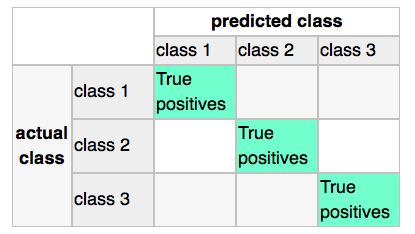


In [131]:
# Using Ridge and Multinomial
logitCV_multi=LogisticRegressionCV(cv=5, penalty='l2', multi_class='multinomial')
logitCV_multi.fit(x_train, y_train) 
print(logitCV_multi.score(x_test,y_test))

0.785714285714


In [132]:
a=logitCV_ovr.coef_
a.shape

(3, 41)

**Baseline model accuracy with the 32 indicators in the original ADNIMERGE_full data is aroung 78.6%.
Both OVR and MULTINOMIAL give similar accuracy.** Next we wil check if imputing the data improves the prediction. First impute wiht mean then with median.

In [133]:
#back to the original data set with missingness, make a copy, and then impute the mean
df_merged2 = df_merged.copy()
df_merged2= df_merged.fillna(df_merged.mean())
df_merged2.isnull().sum()

DX_bl                         0
PTGENDER_Male                 0
PTMARRY_Married               0
PTMARRY_Never married         0
PTMARRY_Widowed               0
PTETHCAT_Not Hisp/Latino      0
PTETHCAT_Unknown              0
PTRACCAT_Asian                0
PTRACCAT_Black                0
PTRACCAT_Hawaiian/Other PI    0
PTRACCAT_More than one        0
PTRACCAT_White                0
APOE4_1.0                     0
APOE4_2.0                     0
AGE                           0
PTEDUCAT                      0
ADAS11_bl                     0
ADAS13_bl                     0
MMSE_bl                       0
RAVLT_immediate_bl            0
RAVLT_learning_bl             0
RAVLT_forgetting_bl           0
RAVLT_perc_forgetting_bl      0
FAQ_bl                        0
Ventricles_bl                 0
Hippocampus_bl                0
WholeBrain_bl                 0
Entorhinal_bl                 0
Fusiform_bl                   0
MidTemp_bl                    0
ICV_bl                        0
MOCA_bl 

In [134]:
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged2.iloc[itrain]
df_test=df_merged2.iloc[itest]
x_features=['PTETHCAT_Not Hisp/Latino','PTETHCAT_Unknown','PTRACCAT_Asian', 'PTRACCAT_Black','PTRACCAT_Black',
            'PTRACCAT_Hawaiian/Other PI','PTRACCAT_More than one','PTRACCAT_White','APOE4_1.0','APOE4_2.0','AGE', 'PTEDUCAT','PTGENDER_Male','PTMARRY_Married','PTMARRY_Never married','PTMARRY_Widowed',
            'ADAS11_bl','ADAS13_bl','MMSE_bl','RAVLT_immediate_bl','RAVLT_learning_bl','RAVLT_forgetting_bl',
            'RAVLT_perc_forgetting_bl', 'FAQ_bl','Ventricles_bl','Hippocampus_bl', 'WholeBrain_bl','Entorhinal_bl',
            'Fusiform_bl','MidTemp_bl','ICV_bl','MOCA_bl', 'EcogPtMem_bl','EcogPtLang_bl','EcogPtVisspat_bl',
            'EcogPtPlan_bl','EcogPtOrgan_bl','EcogPtDivatt_bl','EcogSPTotal_bl','FDG_bl','AV45_bl']
x_train=df_train[x_features]
y_train=df_train[['DX_bl']]
x_test=df_test[x_features]
y_test=df_test[['DX_bl']]
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((140, 41), (140, 1), (140, 41), (140, 1))

In [135]:
# Using Ridge and OVR
logitCV_ovr=LogisticRegressionCV(cv=5, penalty='l2')
logitCV_ovr.fit(x_train, y_train) 
logitCV_multi=LogisticRegressionCV(cv=5, penalty='l2', multi_class='multinomial')
logitCV_multi.fit(x_train, y_train) 

print("OVR:",logitCV_ovr.score(x_test,y_test))
print("Multinomial:",logitCV_multi.score(x_test,y_test))

OVR: 0.735714285714
Multinomial: 0.771428571429


In [136]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test,logitCV_ovr.predict(x_test)))

[[37 21  0]
 [ 7 52  1]
 [ 0  8 14]]


In [137]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test,logitCV_multi.predict(x_test)))

[[43 15  0]
 [10 49  1]
 [ 0  6 16]]


In [138]:
#Imputing with the median
df_merged3 = df_merged.copy()
df_merged3= df_merged.fillna(df_merged.median())
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged3.iloc[itrain]
df_test=df_merged3.iloc[itest]
x_features=['PTETHCAT_Not Hisp/Latino','PTETHCAT_Unknown','PTRACCAT_Asian', 'PTRACCAT_Black','PTRACCAT_Black',
            'PTRACCAT_Hawaiian/Other PI','PTRACCAT_More than one','PTRACCAT_White','APOE4_1.0','APOE4_2.0','AGE', 'PTEDUCAT','PTGENDER_Male','PTMARRY_Married','PTMARRY_Never married','PTMARRY_Widowed',
            'ADAS11_bl','ADAS13_bl','MMSE_bl','RAVLT_immediate_bl','RAVLT_learning_bl','RAVLT_forgetting_bl',
            'RAVLT_perc_forgetting_bl', 'FAQ_bl','Ventricles_bl','Hippocampus_bl', 'WholeBrain_bl','Entorhinal_bl',
            'Fusiform_bl','MidTemp_bl','ICV_bl','MOCA_bl', 'EcogPtMem_bl','EcogPtLang_bl','EcogPtVisspat_bl',
            'EcogPtPlan_bl','EcogPtOrgan_bl','EcogPtDivatt_bl','EcogSPTotal_bl','FDG_bl','AV45_bl']
x_train=df_train[x_features]
y_train=df_train[['DX_bl']]
x_test=df_test[x_features]
y_test=df_test[['DX_bl']]
x_train.shape, y_train.shape, x_test.shape, y_test.shape


((140, 41), (140, 1), (140, 41), (140, 1))

In [139]:
logitCV_ovr=LogisticRegressionCV(cv=5, penalty='l2')
logitCV_ovr.fit(x_train, y_train) 
logitCV_multi=LogisticRegressionCV(cv=5, penalty='l2', multi_class='multinomial')
logitCV_multi.fit(x_train, y_train) 

print("OVR:",logitCV_ovr.score(x_test,y_test))
print("Multinomial:",logitCV_multi.score(x_test,y_test))

OVR: 0.785714285714
Multinomial: 0.814285714286


Imputing with the mean (highest accuracy of 80%) or median (highest accuracy of 76%) gave pretty similar results based on the randomness of the train-test split. But regardless it was similar to the dataset which had all dropped values which makes sense given the missing data was less than 10%.

# Using PCA + expanded dataset


In [140]:
from sklearn.decomposition import PCA

In [361]:
# Choosing just the genetic factors
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged2.iloc[itrain]
df_test=df_merged2.iloc[itest]
x_train=df_train.iloc[:,42:7464]
y_train=df_train[['DX_bl']]
x_test=df_test.iloc[:,42:7464]
y_test=df_test[['DX_bl']]

x_full=df_merged3.iloc[:,42:7464]
y_full=df_merged3.iloc[:,0:1]
x_full.shape, y_full.shape
x_train.shape, y_train.shape, x_test.shape, y_test.shape, x_full.shape

((140, 7421), (140, 1), (140, 7421), (140, 1), (372, 7421))

In [362]:
y_train_np=y_train.values
y_train_np=y_train_np.reshape(-1,)

In [363]:
from sklearn.model_selection import cross_val_score
log_m = LogisticRegression()
scores=[]
for n in range(1, 500): 
    pca = PCA(n_components=n)
    pca.fit(x_train)
    x_train_pca = pca.transform(x_train)
    s_mean=np.mean(cross_val_score(log_m, x_train_pca, y_train_np, cv=5))
    scores.append(s_mean)
scores
np.argmax(scores)

14

In [364]:
pca = PCA(n_components=14)
pca.fit(x_train)
x_train_pca = pca.transform(x_train)
x_test_pca = pca.transform(x_test)
log_pca_train=LogisticRegression(fit_intercept=True).fit(x_train_pca, y_train)
log_pca_test=LogisticRegression(fit_intercept=True).fit(x_test_pca, y_test)
print("Accuracy score train:", log_pca_train.score(x_train_pca, y_train))
print("Accuracy score test:", log_pca_test.score(x_test_pca, y_test))

Accuracy score train: 0.621428571429
Accuracy score test: 0.65


In [142]:
# Choosing ALL factors
itrain, itest = train_test_split(range(df_merged_full.shape[0]), train_size=0.50)
df_train=df_merged2.iloc[itrain]
df_test=df_merged2.iloc[itest]
x_train=df_train.iloc[:, 1:7464]
y_train=df_train[['DX_bl']]
x_test=df_test.iloc[:, 1:7464]
y_test=df_test[['DX_bl']]

x_full=df_merged3.iloc[:, 1:7464]
y_full=df_merged3.iloc[:,0:1]
x_full.shape, y_full.shape
x_train.shape, y_train.shape, x_test.shape, y_test.shape, x_full.shape

((140, 7461), (140, 1), (140, 7461), (140, 1), (372, 7461))

In [143]:
x_train.head()

PTGENDER_Male  PTMARRY_Married  PTMARRY_Never married  PTMARRY_Widowed  \
97               1                1                      0                0   
145              0                1                      0                0   
20               1                1                      0                0   
139              0                0                      0                1   
34               1                1                      0                0   

     PTETHCAT_Not Hisp/Latino  PTETHCAT_Unknown  PTRACCAT_Asian  \
97                          1                 0               0   
145                         1                 0               0   
20                          1                 0               0   
139                         1                 0               0   
34                          1                 0               0   

     PTRACCAT_Black  PTRACCAT_Hawaiian/Other PI  PTRACCAT_More than one  \
97                0                           0                       0   
145               0                           0                       0   
20                0                           0                       0   
139               0                           0                       1   
34                0                           0                       0   

     PTRACCAT_White  APOE4_1.0  APOE4_2.0       AGE  PTEDUCAT  ADAS11_bl  \
97                1          1          0  0.296435 -0.160252  -0.384280   
145               1          0          0  0.795787 -1.688804  -0.882189   
20                1          0          0  0.615465  0.986163  -0.716220   
139               0          0          0  1.364494 -1.688804  -0.052341   
34                1          0          0 -0.965818  1.368301   0.113629   

     ADAS13_bl   MMSE_bl  RAVLT_immediate_bl  RAVLT_learning_bl  \
97   -0.410346 -0.349872            0.450027           0.821017   
145  -0.863436  0.897596            0.772656           1.193386   
20   -0.636891  0.897596            0.691999           0.076280   
139   0.042744  0.481773           -0.356543          -1.040825   
34    0.495834  0.481773           -0.679172          -1.413193   

     RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl    FAQ_bl  Ventricles_bl  \
97             -0.113625                 -0.553600 -0.571650       1.907669   
145            -0.496849                 -0.864037 -0.571650      -0.821563   
20             -0.496849                 -0.737040 -0.571650       0.349328   
139             0.652825                  1.464243 -0.008101      -0.532115   
34             -0.113625                  0.455323 -0.383800      -0.161845   

     Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  MidTemp_bl  \
97         2.169364       1.454680       1.073862     1.171378    1.307822   
145       -0.297255      -1.448450       0.126745    -0.557391   -0.173927   
20        -0.241611      -0.619655       0.336610    -0.309685    0.311114   
139        0.544369      -1.175034      -0.889873    -0.695087   -0.037914   
34        -0.929343       0.139793      -0.350221    -0.248036   -0.388021   

       ICV_bl   MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  EcogPtVisspat_bl  \
97   2.028660 -0.377733      0.118567       0.524998         -0.669033   
145 -1.858555  0.899792     -1.078230      -0.905124         -0.669033   
20  -0.592478  0.899792     -0.907259      -0.905124         -0.669033   
139 -1.499592 -0.888743      1.486335       0.882525         -0.415466   
34   0.173939 -0.377733     -0.565317      -0.547597         -0.669033   

     EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  EcogSPTotal_bl    FDG_bl  \
97        1.089482        0.552388         0.680159        0.744486  0.101323   
145      -0.678792       -0.771489        -0.678313       -0.920378 -0.083700   
20       -0.678792       -0.771489        -1.017931       -0.447759  2.141169   
139      -0.325137       -0.771489         0.000923       -0.376157  0.190982   
34       -0.325137    

In [351]:
y_train_np=y_train.values
y_train_np=y_train_np.reshape(-1,)

log_m = LogisticRegression()
scores=[]
for n in range(1,500): 
    pca = PCA(n_components=n)
    pca.fit(x_train)
    x_train_pca = pca.transform(x_train)
    s_mean=np.mean(cross_val_score(log_m, x_train_pca, y_train_np, cv=5))
    scores.append(s_mean)
scores
np.argmax(scores)

44

In [352]:
pca = PCA(n_components=44)
pca.fit(x_train)
x_train_pca = pca.transform(x_train)
x_test_pca = pca.transform(x_test)
log_pca_train=LogisticRegression(fit_intercept=True).fit(x_train_pca, y_train)
log_pca_test=LogisticRegression(fit_intercept=True).fit(x_test_pca, y_test)
print("Accuracy score train:", log_pca_train.score(x_train_pca, y_train))
print("Accuracy score test:", log_pca_test.score(x_test_pca, y_test))

Accuracy score train: 0.792857142857
Accuracy score test: 0.828571428571



### PCA + Logistic Regression with only gene expression profile
Accuracy of around 65%

### PCA + Logistic Regression with ADNIMERGE + gene expression profile = full data set
Accuracy = 83%


## Random Forest Model: Baseline vs Merged with Genetic Expression Data

Here, we want to try out with Random Forest model on our dataset. First we build a baseline model on the ADNI merged dataset then try to improve it by doing Random Forest Model on the combined dataset (ADNI merged with Genetic Expression data).

In [144]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn import tree
from sklearn import ensemble
from sklearn.model_selection import cross_val_score

In [145]:
rfm_df = pd.read_csv('baseline_draft.csv')

In [146]:
rfm_df.drop('Unnamed: 0', axis=1, inplace=True)
print(rfm_df.shape)

(372, 7462)


In [147]:
rfm_df=rfm_df.dropna(how = 'any')
print(rfm_df.shape)
rfm_df_copy = rfm_df
rfm_df.head()

(280, 7462)


DX_bl  PTGENDER_Male  PTMARRY_Married  PTMARRY_Never married  \
0      3              1                1                      0   
2      3              1                1                      0   
3      3              1                1                      0   
4      3              1                1                      0   
5      3              1                1                      0   

   PTMARRY_Widowed  PTETHCAT_Not Hisp/Latino  PTETHCAT_Unknown  \
0                0                         1                 0   
2                0                         1                 0   
3                0                         1                 0   
4                0                         1                 0   
5                0                         1                 0   

   PTRACCAT_Asian  PTRACCAT_Black  PTRACCAT_Hawaiian/Other PI  \
0               0               0                           0   
2               0               0                           0   
3               0               0                           0   
4               0               0                           0   
5               0               0                           0   

   PTRACCAT_More than one  PTRACCAT_White  APOE4_1.0  APOE4_2.0       AGE  \
0                       0               1          1          0 -0.646787   
2                       0               1          0          1  1.461591   
3                       0               1          1          0 -0.133563   
4                       0               1          1          0  0.851271   
5                       0               1          0          1 -0.813238   

   PTEDUCAT  ADAS11_bl  ADAS13_bl   MMSE_bl  RAVLT_immediate_bl  \
0 -0.924528   1.773326   1.855105 -2.844809           -2.050342   
2  0.604025   1.441387   1.515287 -2.013164           -1.163114   
3 -1.688804   0.279599   0.609107 -1.181518           -0.679172   
4  0.986163   0.777508   0.609107 -1.181518           -0.679172   
5 -1.688804   1.275417   1.628560 -2.844809           -1.163114   

   RAVLT_learning_bl  RAVLT_forgetting_bl  RAVLT_perc_forgetting_bl    FAQ_bl  \
0           0.076280            -0.496849                  0.253537  1.494695   
2          -1.413193             0.269600                  1.464243  2.809642   
3           0.076280             1.036050                  0.791629  0.743297   
4           0.076280            -0.113625                 -0.049139 -0.195951   
5          -0.668457             1.036050                  1.464243  0.743297   

   Ventricles_bl  Hippocampus_bl  WholeBrain_bl  Entorhinal_bl  Fusiform_bl  \
0       0.861261       -0.990204       0.052062       0.348874     0.121492   
2       1.531800       -1.506655       0.760616      -1.910580    -0.030971   
3       0.271971       -1.507525      -0.063763      -0.798569     0.508000   
4      -0.012636       -1.296249       0.609698       1.098392     0.059473   
5       0.043507       -1.091060      -0.501148      -1.128356    -1.290539   

   MidTemp_bl    ICV_bl   MOCA_bl  EcogPtMem_bl  EcogPtLang_bl  \
0   -0.929554  0.539738 -1.655259      0.973422       2.848937   
2    0.087304  1.708127 -0.633238      1.315364      -0.011292   
3   -0.711862 -0.575519 -0.122228      0.460509      -0.011292   
4   -0.516478  0.893285  0.133277      1.486335      -0.368834   
5   -1.190425  0.100109 -1.655259      1.315364       1.418831   

   EcogPtVisspat_bl  EcogPtPlan_bl  EcogPtOrgan_bl  EcogPtDivatt_bl  \
0          1.359464       2.857756        2.141048         0.680159   
2         -0.669033       0.735828        0.287623         0.680159   
3          0.852331       0.382173        0.287623        -0.338695   
4          0.598782      -0.678792       -0.241941         0.340541   
5          0.598782      -0.325137       -0.453757         1.019777   

   EcogSPTotal_bl    FDG_bl   AV45_bl  LOC645432  LOC127254   LOC9545  \
0        1.878005 -2.215459 -0.285672   0.933984  -0.905614 -0.977729   
2        1.598

In [148]:
from sklearn.model_selection import train_test_split
X =rfm_df_copy[['AGE', 'PTEDUCAT', 'APOE4_1.0','APOE4_2.0','PTGENDER_Male','PTMARRY_Married','PTMARRY_Never married','PTMARRY_Widowed', 'ADAS11_bl','ADAS13_bl','MMSE_bl','RAVLT_immediate_bl',
                    'RAVLT_learning_bl','RAVLT_forgetting_bl', 'RAVLT_perc_forgetting_bl','FAQ_bl','Ventricles_bl',
                    'Hippocampus_bl', 'WholeBrain_bl','Entorhinal_bl','Fusiform_bl','MidTemp_bl','ICV_bl','MOCA_bl',
                    'EcogPtMem_bl','EcogPtLang_bl','EcogPtVisspat_bl','EcogPtPlan_bl','EcogPtOrgan_bl','EcogPtDivatt_bl',
                    'EcogSPTotal_bl','FDG_bl','AV45_bl' ]]
y = rfm_df_copy['DX_bl']

In [149]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

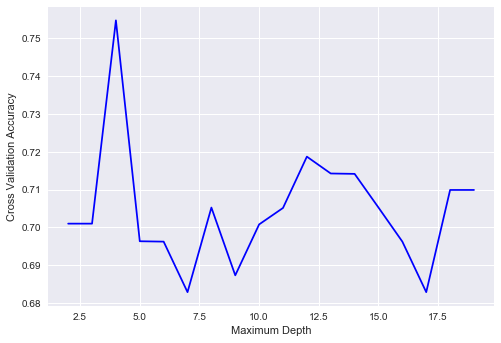

In [150]:
depth = []
tree_start = 2
tree_end   = 20
for i in range(tree_start,tree_end):
    dt = DecisionTreeClassifier(max_depth=i)
    # Perform 5-fold cross validation 
    scores = cross_val_score(estimator=dt, X=X_train, y=y_train, cv=5, n_jobs=-1)
    depth.append((i,scores.mean()))
plt.plot(np.array(depth)[:,0], np.array(depth)[:,1], 'b-')
plt.ylabel("Cross Validation Accuracy")
plt.xlabel("Maximum Depth")
plt.show()
#Before using Random Forest model on the dataset, we have used Decision Tree classifier 
#to see the best depth for the model by employing 5 fold cross validation.

In [151]:
best_depth = np.argmax(np.array(depth)[:,1]) + tree_start
best_depth

4

In [152]:
dt = DecisionTreeClassifier(max_depth=best_depth)
dt_fitted = dt.fit(X_train, y_train)
dt_fitted.score(X_test, y_test)

0.7321428571428571

In [153]:
train_scores = []
test_scores = []
trees = [2**x for x in range(10)]
for n_trees in trees:
    rf = RandomForestClassifier(n_estimators=n_trees, max_features='sqrt')
    test_scores.append(metrics.accuracy_score(y_test, rf.fit(X_train, y_train).predict(X_test)))
    train_scores.append(metrics.accuracy_score(y_train, rf.fit(X_train, y_train).predict(X_train)))
    
trees
#Now it is time to use Random Forest to get our test scores.

[1, 2, 4, 8, 16, 32, 64, 128, 256, 512]

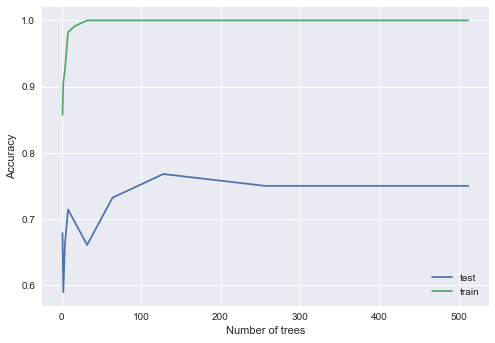

Best score 0.767857142857
Number of trees 128


In [154]:
plt.plot(trees, test_scores, label='test')
plt.plot(trees, train_scores, label='train')
plt.legend(loc='best')
plt.xlabel('Number of trees')
plt.ylabel('Accuracy')
plt.show()
#print(test_scores)
best = np.argmax(np.array(test_scores))
print('Best score', test_scores[best])
print('Number of trees',trees[best])

The best score we got at the depth of 3, is 0.8214. This is our base model for the dataset. For the Random Forest, we create our baseline model similiar to our baseline model using Logistics classifier, that is using all screening predictors (including APOE4). Our expanded model will be built using all screening predictors and the genetic expression data.

In [155]:
accuracies_train = []
accuracies_test = []
trees = [2**x for x in range(8)]
for md in [1,3,10,None]:
    depth_accuracies_train = []
    depth_accuracies_test = []
    for n in trees:
        ada=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=md),n_estimators=n, learning_rate=.01)
        depth_accuracies_train.append(metrics.accuracy_score(y_train, ada.fit(X_train,y_train).predict(X_train)))
        depth_accuracies_test.append(metrics.accuracy_score(y_test, ada.fit(X_train,y_train).predict(X_test)))
    accuracies_train.append(depth_accuracies_train)
    accuracies_test.append(depth_accuracies_test)

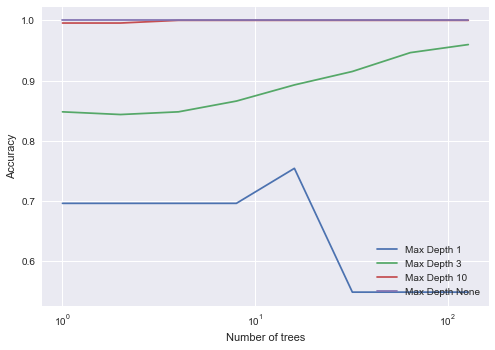

In [156]:
for i, md in enumerate([1,3,10,None]):
    plt.semilogx(trees, accuracies_train[i], label='Max Depth {}'.format(md))
plt.legend(loc=4)
plt.xlabel('Number of trees')
plt.ylabel('Accuracy')
plt.show()

Here we can see that when the number of trees increases, accuracy increases, but it overfits

In [157]:
#Expanded model
rfm_df_expanded = rfm_df
y_expanded = rfm_df_expanded['DX_bl']
rfm_df_expanded.drop('DX_bl', axis=1, inplace=True)
X_expanded = rfm_df_expanded
X_expanded.head()

PTGENDER_Male  PTMARRY_Married  PTMARRY_Never married  PTMARRY_Widowed  \
0              1                1                      0                0   
2              1                1                      0                0   
3              1                1                      0                0   
4              1                1                      0                0   
5              1                1                      0                0   

   PTETHCAT_Not Hisp/Latino  PTETHCAT_Unknown  PTRACCAT_Asian  PTRACCAT_Black  \
0                         1                 0               0               0   
2                         1                 0               0               0   
3                         1                 0               0               0   
4                         1                 0               0               0   
5                         1                 0               0               0   

   PTRACCAT_Hawaiian/Other PI  PTRACCAT_More than one  PTRACCAT_White  \
0                           0                       0               1   
2                           0                       0               1   
3                           0                       0               1   
4                           0                       0               1   
5                           0                       0               1   

   APOE4_1.0  APOE4_2.0       AGE  PTEDUCAT  ADAS11_bl  ADAS13_bl   MMSE_bl  \
0          1          0 -0.646787 -0.924528   1.773326   1.855105 -2.844809   
2          0          1  1.461591  0.604025   1.441387   1.515287 -2.013164   
3          1          0 -0.133563 -1.688804   0.279599   0.609107 -1.181518   
4          1          0  0.851271  0.986163   0.777508   0.609107 -1.181518   
5          0          1 -0.813238 -1.688804   1.275417   1.628560 -2.844809   

   RAVLT_immediate_bl  RAVLT_learning_bl  RAVLT_forgetting_bl  \
0           -2.050342           0.076280            -0.496849   
2           -1.163114          -1.413193             0.269600   
3           -0.679172           0.076280             1.036050   
4           -0.679172           0.076280            -0.113625   
5           -1.163114          -0.668457             1.036050   

   RAVLT_perc_forgetting_bl    FAQ_bl  Ventricles_bl  Hippocampus_bl  \
0                  0.253537  1.494695       0.861261       -0.990204   
2                  1.464243  2.809642       1.531800       -1.506655   
3                  0.791629  0.743297       0.271971       -1.507525   
4                 -0.049139 -0.195951      -0.012636       -1.296249   
5                  1.464243  0.743297       0.043507       -1.091060   

   WholeBrain_bl  Entorhinal_bl  Fusiform_bl  MidTemp_bl    ICV_bl   MOCA_bl  \
0       0.052062       0.348874     0.121492   -0.929554  0.539738 -1.655259   
2       0.760616      -1.910580    -0.030971    0.087304  1.708127 -0.633238   
3      -0.063763      -0.798569     0.508000   -0.711862 -0.575519 -0.122228   
4       0.609698       1.098392     0.059473   -0.516478  0.893285  0.133277   
5      -0.501148      -1.128356    -1.290539   -1.190425  0.100109 -1.655259   

   EcogPtMem_bl  EcogPtLang_bl  EcogPtVisspat_bl  EcogPtPlan_bl  \
0      0.973422       2.848937          1.359464       2.857756   
2      1.315364      -0.011292         -0.669033       0.735828   
3      0.460509      -0.011292          0.852331       0.382173   
4      1.486335      -0.368834          0.598782      -0.678792   
5      1.315364       1.418831          0.598782      -0.325137   

   EcogPtOrgan_bl  EcogPtDivatt_bl  EcogSPTotal_bl    FDG_bl   AV45_bl  \
0        2.141048         0.680159        1.878005 -2.215459 -0.285672   
2        0.287623         0.680159        1.598794 -1.620214  0.768661   
3        0.287623        -0.338695        0.886171 -0.429079  0.566487   
4       -0.241941         0.340541        0.744486 -0.416162 -1.138937   
5       -0.453757         1.019777        1.633262 -1.798448 

In [158]:
X_train_exp, X_test_exp, y_train_exp, y_test_exp = train_test_split(X_expanded, y_expanded, test_size=0.2)

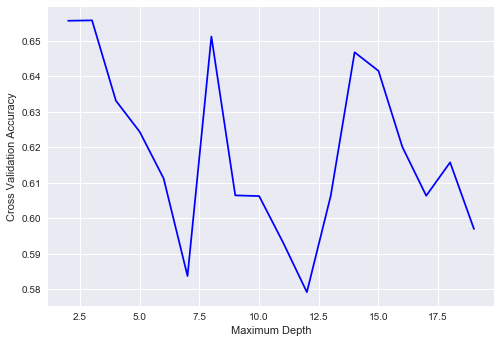

In [159]:
depth_exp = []
tree_start = 2
tree_end   = 20
for i in range(tree_start,tree_end):
    dt_exp = DecisionTreeClassifier(max_depth=i)
    # Perform 5-fold cross validation 
    scores = cross_val_score(estimator=dt_exp, X=X_train_exp, y=y_train_exp, cv=5, n_jobs=-1)
    depth_exp.append((i,scores.mean()))
plt.plot(np.array(depth_exp)[:,0], np.array(depth_exp)[:,1], 'b-')
plt.ylabel("Cross Validation Accuracy")
plt.xlabel("Maximum Depth")
plt.show()

In [160]:
best_depth = np.argmax(np.array(depth_exp)[:,1]) + tree_start
best_depth

3

In [161]:
dt = DecisionTreeClassifier(max_depth=best_depth)
dt_fitted = dt.fit(X_train_exp, y_train_exp)
dt_fitted.score(X_test_exp, y_test_exp)

0.7321428571428571

In [162]:
train_scores_exp = []
test_scores_exp = []
trees = [2**x for x in range(10)]
for n_trees in trees:
    rf = RandomForestClassifier(n_estimators=n_trees, max_features='sqrt')
    test_scores_exp.append(metrics.accuracy_score(y_test_exp, rf.fit(X_train_exp, y_train_exp).predict(X_test_exp)))
    train_scores_exp.append(metrics.accuracy_score(y_train_exp, rf.fit(X_train_exp, y_train_exp).predict(X_train_exp)))
    
trees

[1, 2, 4, 8, 16, 32, 64, 128, 256, 512]

In [163]:
test_scores_exp

[0.4642857142857143,
 0.375,
 0.5178571428571429,
 0.44642857142857145,
 0.5714285714285714,
 0.5714285714285714,
 0.6071428571428571,
 0.5178571428571429,
 0.5892857142857143,
 0.6428571428571429]

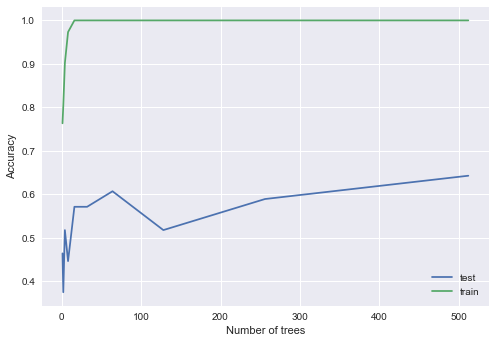

Best score 0.642857142857
Number of trees 512


In [164]:
plt.plot(trees, test_scores_exp, label='test')
plt.plot(trees, train_scores_exp, label='train')
plt.legend(loc='best')
plt.xlabel('Number of trees')
plt.ylabel('Accuracy')
plt.show()

best = np.argmax(np.array(test_scores_exp))
print('Best score', test_scores_exp[best])
print('Number of trees',trees[best])

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
accuracies_train_exp = []
accuracies_test_exp = []
trees = [2**x for x in range(8)]
for md in [1,2,10,None]:
    depth_accuracies_train = []
    depth_accuracies_test = []
    for n in trees:
        ada=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=md),n_estimators=n, learning_rate=.01)
        depth_accuracies_train.append(metrics.accuracy_score(y_train_exp, ada.fit(X_train_exp,y_train_exp).predict(X_train_exp)))
        depth_accuracies_test.append(metrics.accuracy_score(y_test_exp, ada.fit(X_train_exp,y_train_exp).predict(X_test_exp)))
    accuracies_train_exp.append(depth_accuracies_train)
    accuracies_test_exp.append(depth_accuracies_test)

In [ ]:
print(trees)
print(accuracies_test_exp)
print('The best accuracy with AdaBoostClassifier', np.max(np.array(accuracies_test_exp)))
print('Number of trees', 2**np.argmax(np.max(accuracies_test_exp, axis=0)))

# Appendix:

### Details of Data clean-up

#### ADNIMERGE_full: 
After analyzing the ADNIMERGE data, we found that there are few issues need to be solved: longitudinal factor and correlation. Here, we have chosen only baseline visit data because:
It is little relevance if we choose the baseline or last visit since we believe that the genetic expression does not change over few years which the study has taken place
We need some criteria to have a unique key of each observation. Problem is a single patient (PTID) has multiple visits, so either we combine multiple data points into a longitudinal factor or keep only one visit. 
We want to extend the dataset based on PTID with genetic expression data, which does not have have a longitudinal aspect 
Hence keeping only the baseline data can be justified and we chose to ignore the longitudinal aspect. Here we have looked at what age the AD happens and how it is distributed. The histograms illustrates that not all observations are AD, but the results are varying degrees. 

*Getting rid of administrative data:* There are many columns in the dataset which are only for administrative purposes (dates, months, field strength etc) and have no predictive power or provide any incremental value to our purpose. We dropped these manually. An unfortunate casualty is the PIB variable (the B-amyloid) which was collected only for ADNI1 thus is unavailable for ADNI2. 

*Getting rid of anachronistic data:* The next stage of drops are based on the fact that we are taking only baseline observations thus for any given predictor (eg. hippocampus) we need to drop the endline observation. The odd thing is they still remained in the dataset despite filtering by VISCODE=bl, but both values baseline and the pseudo 'endline' values are the same. Dropped these psuedo endline values and kept only 'bl' suffixed values.

*Getting rid of variables which don’t make predictive or scientific sense:*
- CDR is highly predictive of DX-bl thus dropped it as it is a test for Clinical Dementia, one of the advanced symptoms of Alzheimer's.
- EcogSP tests: these are everyday cognitive tests verified by the study partner who comes with the participant. This will not a strong predictor so dropped them.

After the clean up we were left with th **789 observation and 34 columns**.

### ADNI Gene Expression Profile:
This dataset contains the gene expression profile of 744 patients from ADNI2 and ADNI GO. The ADNI Gene_Expression_profile contains about 49386 probe sets with information on LocusLink and Symbols. The LocusLink contains the information on the gene symbols. In order to clean the data, we have taken following steps:

- Since we are working with only ADNI2, we filtered out ADNIGO observations.
- There are a number of empty cells for the LocusLink. Since LocusLink represents the specific genetic expression in each of the ProbeSet, we cannot impute the values on each of these empty LocusLinks. Therefore we decided to dropped the ProbeSet values for all observations (that applies to 744 patients) which has no LocusLink. In dropping these, we removed certain combined information in the Symbols, which we understand as some synthetic values after genetic expression data is collected. After dropping these empty cells, we got about 43785 LocusLinks to predict the dependent variable. 
- There were multiple LocusLinks. We dealt with the multiple Locuslinks by two ways. First we limited our ProbeSet to all values with “_at” rather than “_s_at” or “x_at” which we believed were equally valid ways to choose our LocusLinks from. By limiting to all ProbeSets with “_at” extension, we were able to reduce most duplicates in the LocusLink. By doing so, the number of predictors were reduced to 9332 predictors (genes). Second, after filtering, we took the unique values for the LocusLink since different ProbeSets had same LocusLink. The underlying reason was that since the LocusLink had the same name with different ProbeSet, the correlation with same genes were very high. By doing so, the number of predictors were reduced to 7421. 
After the clean up we were left with th **452 observations and 7421 genetic expressions.**

**The two datasets were merged by the unique key PTID to create an expanded dataset of 372 observations and 7455 columns.**
